In [1]:
import os
os.environ['TF_USE_LEGACY_KERAS'] = '1'

from tqdm import tqdm
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

#from google.colab import drive
# drive.mount('/content/drive', force_remount=True) ## If you want to use your google drive

def load_real_samples(scale=False):
    # We load 20,000 samples only to avoid memory issues, you can  change this value
    X = np.load('face_dataset_64x64.npy',  fix_imports=True,encoding='latin1')[:20000, :, :, :]
    print(X.shape)
    # Scale samples in range [-127, 127]
    if scale:
        X = (X - 127.5) * 2
    return X / 255.

# We will use this function to display the output of our models throughout this notebook
def grid_plot(images, epoch='', name='', n=3, save=False, scale=False):
    if scale:
        images = (images + 1) / 2.0
    for index in range(n * n):
        plt.subplot(n, n, 1 + index)
        plt.axis('off')
        plt.imshow(images[index])
    fig = plt.gcf()
    fig.suptitle(name + '  '+ str(epoch), fontsize=14)
    if save:
        filename = 'results/generated_plot_e%03d_f.png' % (epoch+1)
        plt.savefig(filename)
        plt.close()
    plt.show()

from tensorflow.keras.layers import Dense, Flatten, Conv2D, Conv2DTranspose, Reshape

def build_conv_net(in_shape, out_shape, n_downsampling_layers=4, filters=128, out_activation='sigmoid'):
    """
    Build a basic convolutional network
    """
    default_args=dict(kernel_size=(3,3), strides=(2,2), padding='same', activation='relu')

    input = tf.keras.Input(shape=in_shape)
    x = Conv2D(filters=filters, name='enc_input', **default_args)(input)

    for _ in range(n_downsampling_layers):
        x = Conv2D(**default_args, filters=filters)(x)

    x = Flatten()(x)
    x = Dense(out_shape, activation=out_activation, name='enc_output')(x)

    model = tf.keras.Model(inputs=input, outputs=x, name='Encoder')

    model.summary()
    return model


def build_deconv_net(latent_dim, n_upsampling_layers=4, filters=128, activation_out='sigmoid'):
    """
    Build a deconvolutional network for decoding/upscaling latent vectors

    When building the deconvolutional architecture, usually it is best to use the same layer sizes that
    were used in the downsampling network and the Conv2DTranspose layers are used instead of Conv2D layers.
    Using identical layers and hyperparameters ensures that the dimensionality of our output matches the
    shape of our input images.
    """
    input = tf.keras.Input(shape=(latent_dim,))
    x = Dense(4 * 4 * 64, input_dim=latent_dim, name='dec_input')(input)
    x = Reshape((4, 4, 64))(x) # This matches the output size of the downsampling architecture

    default_args=dict(kernel_size=(3,3), strides=(2,2), padding='same', activation='relu')

    for i in range(n_upsampling_layers):
        x = Conv2DTranspose(filters=filters, **default_args)(x)

    # This last convolutional layer converts back to 3 channel RGB image
    x = Conv2D(filters=3, kernel_size=(3,3), padding='same', activation=activation_out, name='dec_output')(x)

    model = tf.keras.Model(inputs=input, outputs=x, name='Decoder')
    model.summary()
    return model

def build_convolutional_autoencoder(data_shape, latent_dim, filters=128):
    encoder = build_conv_net(in_shape=data_shape, out_shape=latent_dim, filters=filters)
    decoder = build_deconv_net(latent_dim, activation_out='sigmoid', filters=filters)

    # We connect encoder and decoder into a single model
    autoencoder = tf.keras.Sequential([encoder, decoder])

    # Binary crossentropy loss - pairwise comparison between input and output pixels
    autoencoder.compile(loss='binary_crossentropy', optimizer='adam')

    return autoencoder

2025-12-08 20:30:32.530934: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-12-08 20:30:32.780894: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2025-12-08 20:30:36.373006: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2025-12-08 20:30:38.097758: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-12-08 20:30:40.305662: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been 

In [2]:
class Sampling(tf.keras.layers.Layer):
    """
    Custom layer for the variational autoencoder
    It takes two vectors as input - one for means and other for variances of the latent variables described by a multimodal gaussian
    Its output is a latent vector randomly sampled from this distribution
    """
    def call(self, inputs):
        z_mean, z_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_var) * epsilon

def build_vae(data_shape, latent_dim, filters=128):

    # Building the encoder - starts with a simple downsampling convolutional network
    encoder = build_conv_net(data_shape, latent_dim*2, filters=filters)

    # Adding special sampling layer that uses the reparametrization trick
    z_mean = Dense(latent_dim)(encoder.output)
    z_var = Dense(latent_dim)(encoder.output)
    z = Sampling()([z_mean, z_var])

    # Connecting the two encoder parts
    encoder = tf.keras.Model(inputs=encoder.input, outputs=z)

    # Defining the decoder which is a regular upsampling deconvolutional network
    decoder = build_deconv_net(latent_dim, activation_out='sigmoid', filters=filters)
    vae = tf.keras.Model(inputs=encoder.input, outputs=decoder(z))

    # Define a custom layer for the KL loss calculation
    class KLLossLayer(tf.keras.layers.Layer):
        def call(self, inputs):
            z_mean, z_var = inputs
            kl_loss = -0.5 * tf.reduce_sum(z_var - tf.square(z_mean) - tf.exp(z_var) + 1)
            # Add the KL loss to the model's losses
            self.add_loss(kl_loss / tf.cast(tf.keras.backend.prod(data_shape), tf.float32))
            return inputs  # Pass through the inputs unchanged

    # Apply the custom layer to z_mean and z_var
    _, _ = KLLossLayer()([z_mean, z_var])

    vae.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3), loss='binary_crossentropy')

    return encoder, decoder, vae

In [3]:
from tensorflow.keras.optimizers.legacy import Adam

def build_gan(data_shape, latent_dim, filters=128, lr=0.0002, beta_1=0.5):
    optimizer = Adam(learning_rate=lr, beta_1=beta_1)

    # Usually thew GAN generator has tanh activation function in the output layer
    generator = build_deconv_net(latent_dim, activation_out='tanh', filters=filters)

    # Build and compile the discriminator
    discriminator = build_conv_net(in_shape=data_shape, out_shape=1, filters=filters) # Single output for binary classification
    discriminator.compile(loss='binary_crossentropy', optimizer=optimizer)

    # End-to-end GAN model for training the generator
    discriminator.trainable = False
    true_fake_prediction = discriminator(generator.output)
    GAN = tf.keras.Model(inputs=generator.input, outputs=true_fake_prediction)
    GAN.compile(loss='binary_crossentropy', optimizer=optimizer)

    return discriminator, generator, GAN

def get_batch(generator, dataset, batch_size=64):
    """
    Fetches one batch of data and ensures no memory leaks by using TensorFlow operations.
    """
    half_batch = batch_size // 2

    # Generate fake images
    latent_vectors = tf.random.normal(shape=(half_batch, latent_dim))
    fake_data = generator(latent_vectors, training=False)

    # Select real images
    idx = np.random.randint(0, dataset.shape[0], half_batch)
    real_data = dataset[idx]

    # Combine
    X = tf.concat([real_data, fake_data], axis=0)
    y = tf.concat([tf.ones((half_batch, 1)), tf.zeros((half_batch, 1))], axis=0)

    return X, y


def train_gan(generator, discriminator, gan, dataset, latent_dim, n_epochs=20, batch_size=64):
    """
    Train the GAN with memory-efficient updates and clear session management.
    """
    batches_per_epoch = dataset.shape[0] // batch_size

    for epoch in range(n_epochs):
        for batch in tqdm(range(batches_per_epoch)):
            # Train Discriminator
            X, y = get_batch(generator, dataset, batch_size)
            discriminator_loss = discriminator.train_on_batch(X, y)

            # Train Generator
            latent_vectors = tf.random.normal(shape=(batch_size, latent_dim))
            y_gan = tf.ones((batch_size, 1))
            generator_loss = gan.train_on_batch(latent_vectors, y_gan)

        # Generate and visualize after each epoch
        noise = tf.random.normal(shape=(16, latent_dim))
        generated_images = generator(noise, training=False)
        grid_plot(generated_images.numpy(), epoch, name='Generated Images', n=3)

        # Clear backend session to free memory
        tf.keras.backend.clear_session()

In [4]:
import kagglehub

# Download dataset
path = kagglehub.dataset_download("kostastokis/simpsons-faces")

print("Path to dataset files:", path)

/vol/home/s3692566/.local/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Path to dataset files: /vol/home/s3692566/.cache/kagglehub/datasets/kostastokis/simpsons-faces/versions/1


In [5]:

from PIL import Image

def process_images(input_dir, size=(64, 64)):
    data = []
    for filename in os.listdir(input_dir):
        if filename.endswith('.png') or filename.endswith('.jpg'):
            img_path = os.path.join(input_dir, filename)
            with Image.open(img_path) as img:
                img = img.convert("RGB")
                data.append(np.array(img, dtype=np.uint8))           
    dataset_np = np.stack(data, axis=0)
    np.save('simpsons_faces_dataset.npy', dataset_np)
    
input_directory = path + '/cropped'
process_images(input_directory)

(9877, 64, 64, 3)


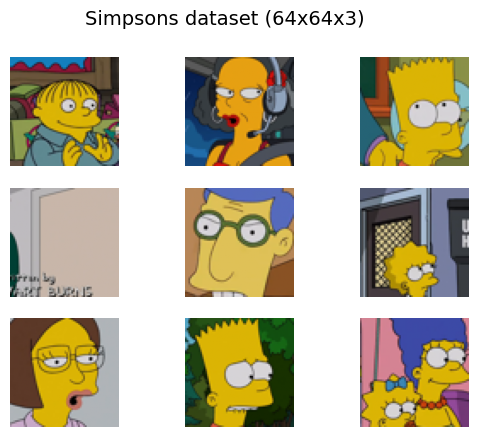

In [4]:
X = np.load('simpsons_faces_dataset.npy',  fix_imports=True,encoding='latin1')#[:5000, :, :, :]
print(X.shape)
dataset = X / 255.

grid_plot(dataset[np.random.randint(0, 1000, 9)], name='Simpsons dataset (64x64x3)', n=3)

I0000 00:00:1765203909.846000   14640 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-12-08 15:25:09.851163: W tensorflow/core/common_runtime/gpu/gpu_device.cc:2343] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


Model: "Encoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 enc_input (Conv2D)          (None, 32, 32, 128)       3584      
                                                                 
 conv2d (Conv2D)             (None, 16, 16, 128)       147584    
                                                                 
 conv2d_1 (Conv2D)           (None, 8, 8, 128)         147584    
                                                                 
 conv2d_2 (Conv2D)           (None, 4, 4, 128)         147584    
                                                                 
 conv2d_3 (Conv2D)           (None, 2, 2, 128)         147584    
                                                                 
 flatten (Flatten)           (None, 512)               0   

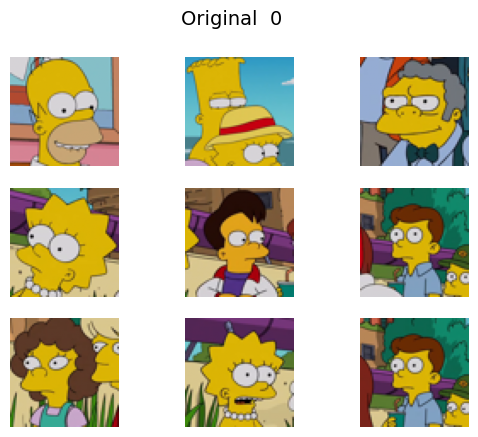

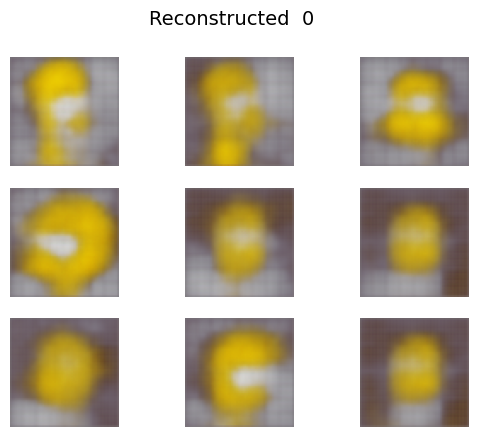


Epoch:  1
1/1 [==============================] - 0s 17ms/step


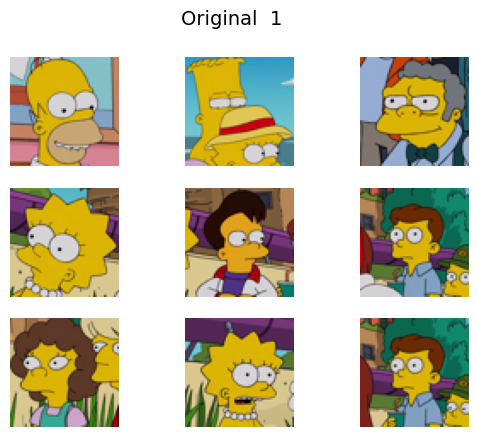

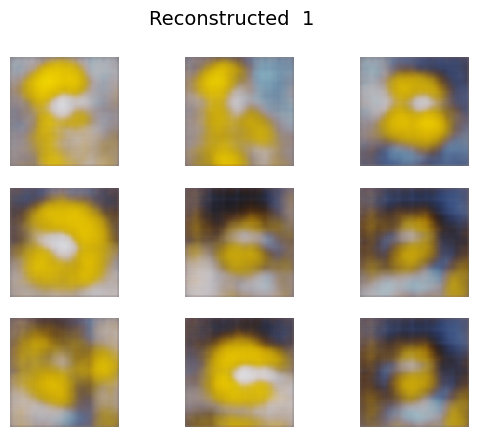


Epoch:  2
1/1 [==============================] - 0s 16ms/step


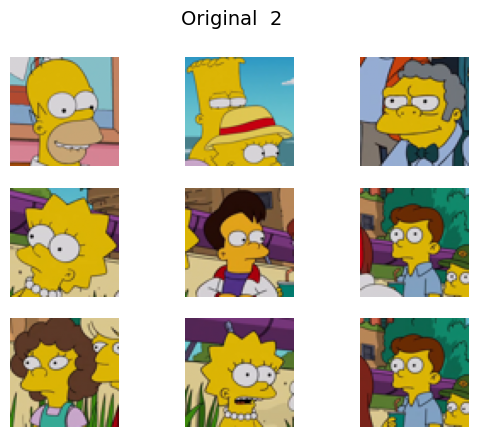

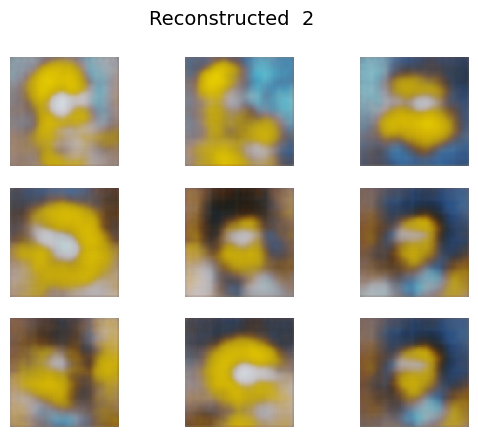


Epoch:  3
1/1 [==============================] - 0s 24ms/step


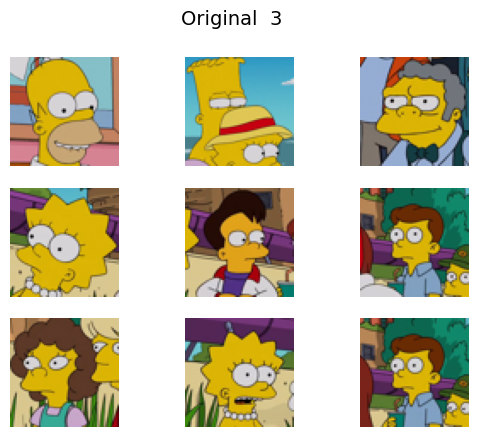

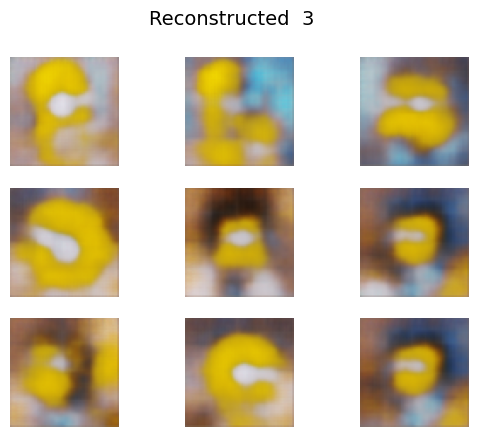


Epoch:  4
1/1 [==============================] - 0s 22ms/step


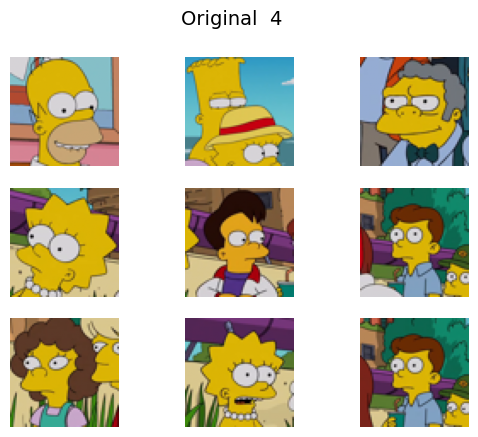

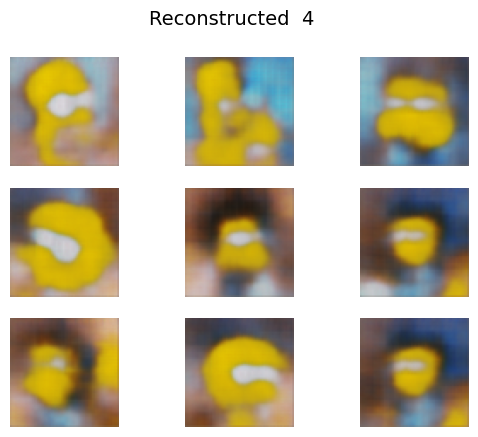


Epoch:  5
1/1 [==============================] - 0s 22ms/step


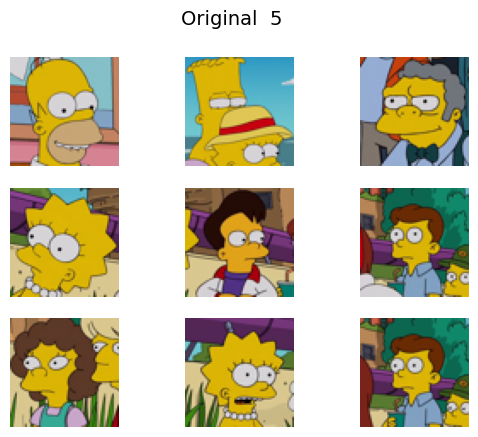

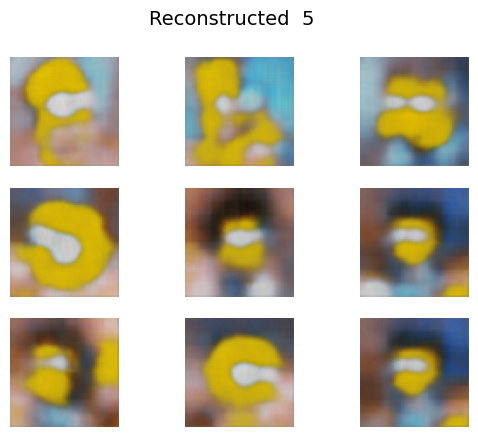


Epoch:  6
1/1 [==============================] - 0s 23ms/step


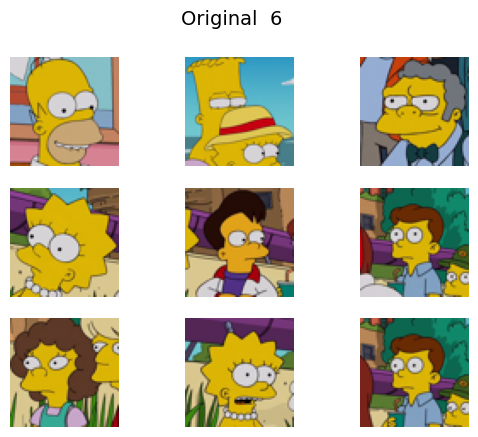

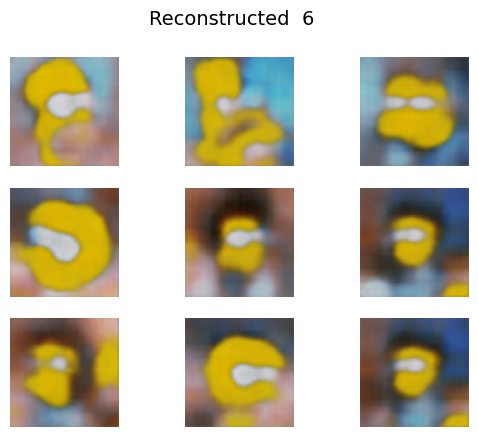


Epoch:  7
1/1 [==============================] - 0s 22ms/step


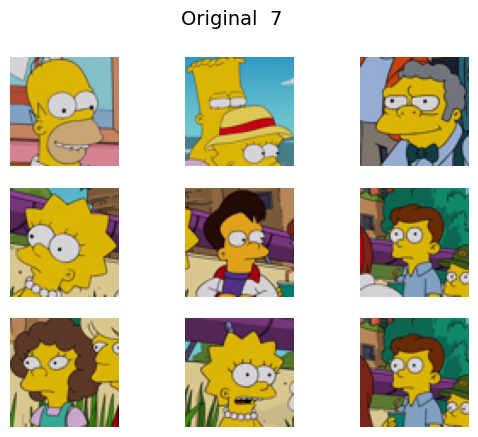

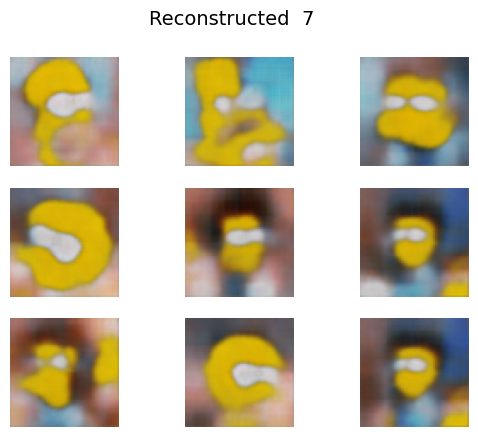


Epoch:  8
1/1 [==============================] - 0s 23ms/step


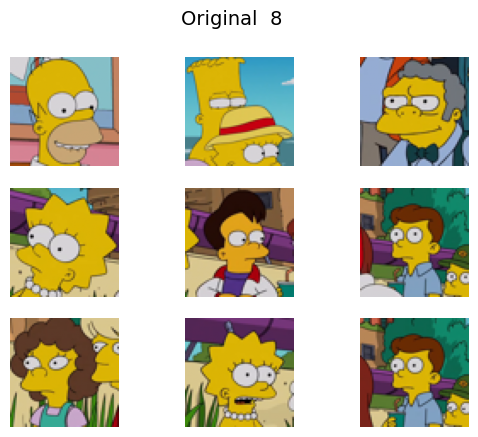

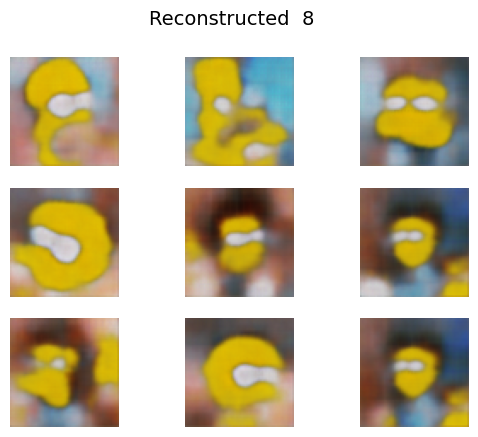


Epoch:  9
1/1 [==============================] - 0s 22ms/step


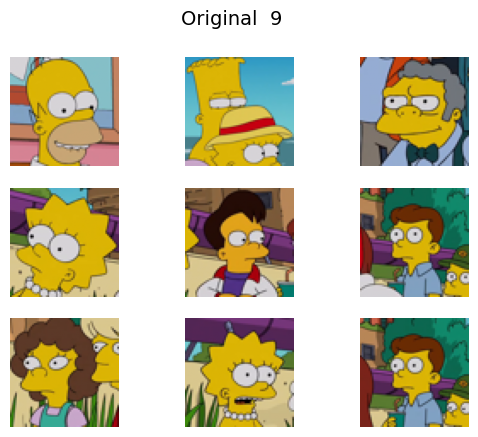

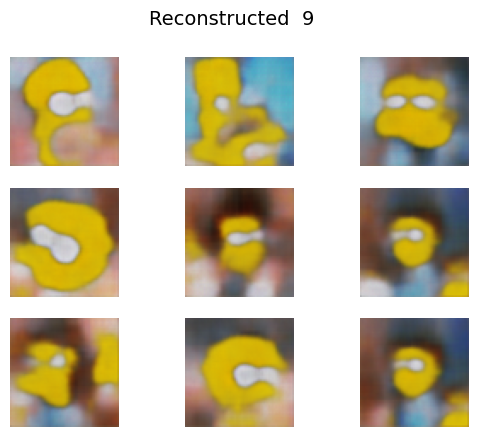


Epoch:  10
1/1 [==============================] - 0s 23ms/step


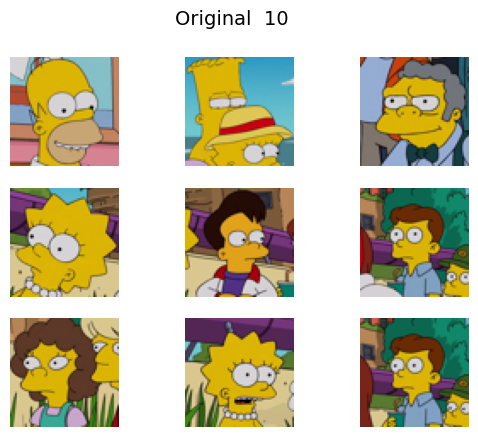

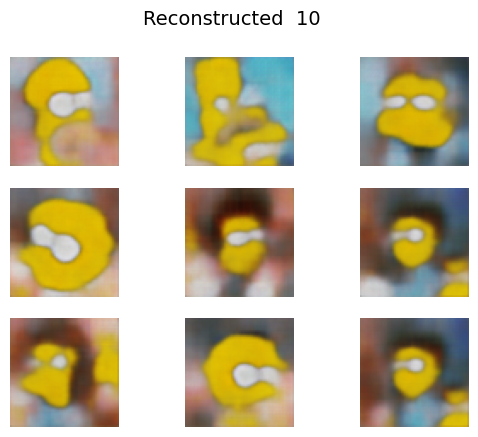


Epoch:  11
1/1 [==============================] - 0s 22ms/step


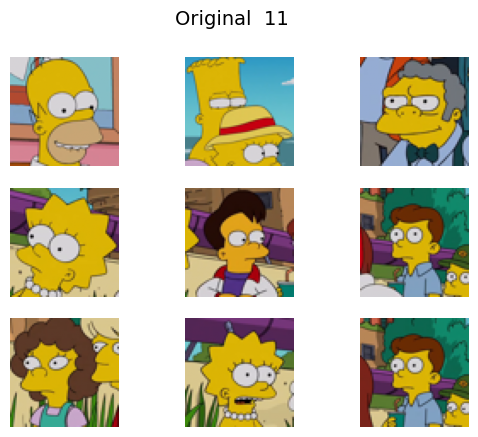

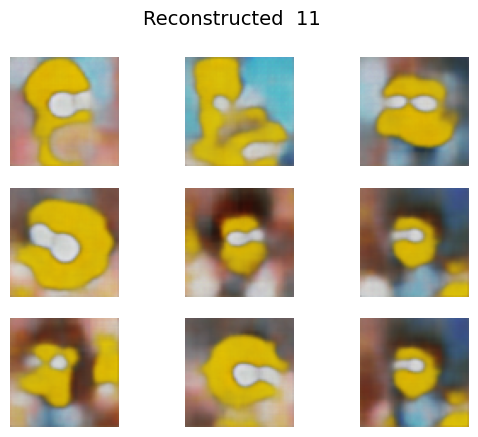


Epoch:  12
1/1 [==============================] - 0s 23ms/step


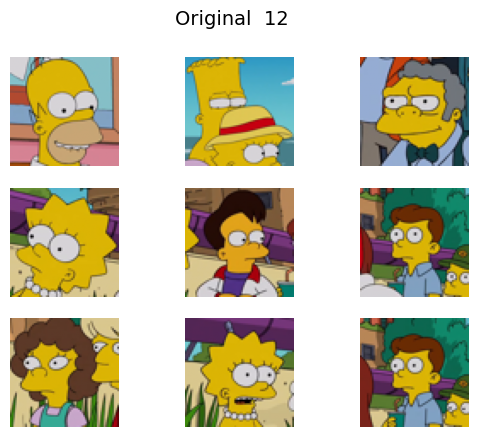

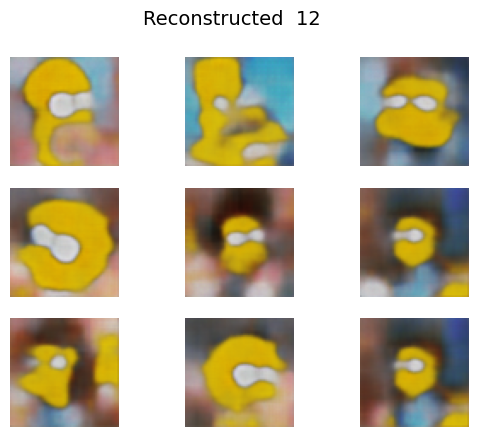


Epoch:  13
1/1 [==============================] - 0s 22ms/step


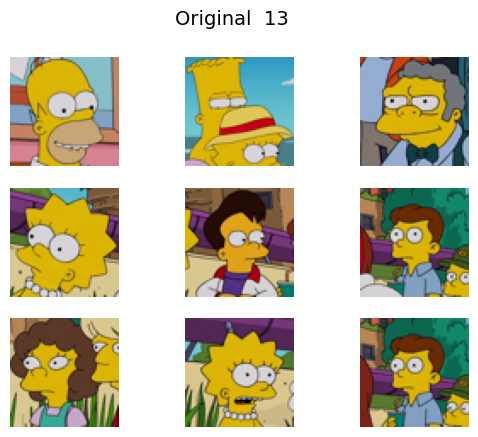

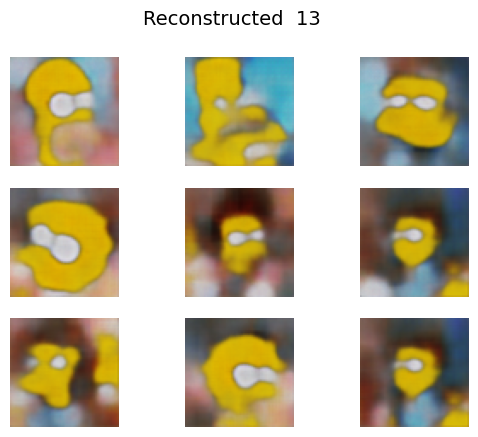


Epoch:  14
1/1 [==============================] - 0s 22ms/step


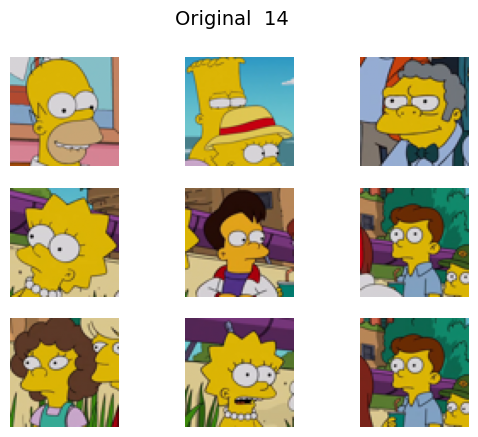

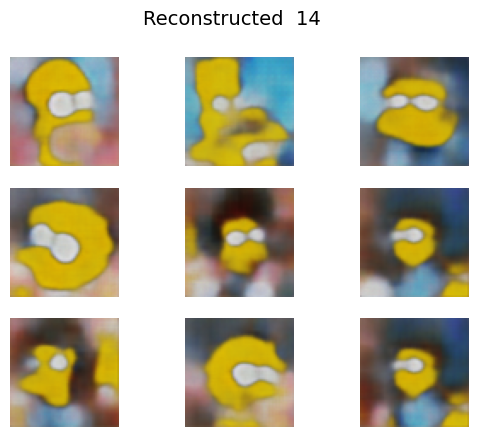


Epoch:  15
1/1 [==============================] - 0s 22ms/step


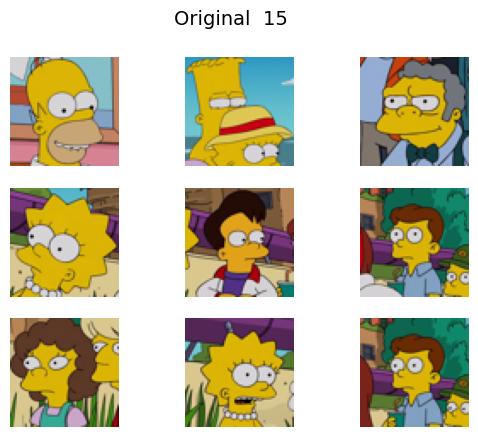

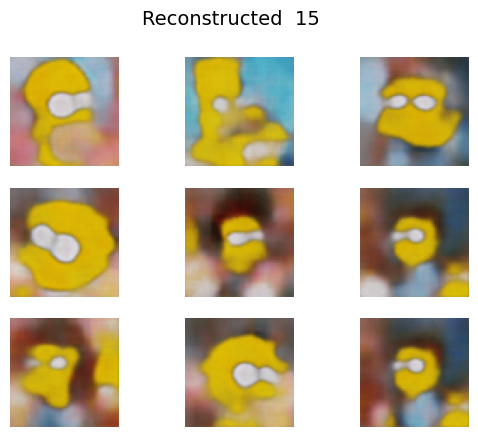


Epoch:  16
1/1 [==============================] - 0s 23ms/step


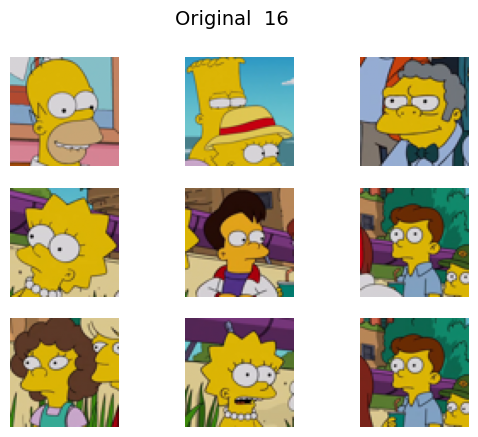

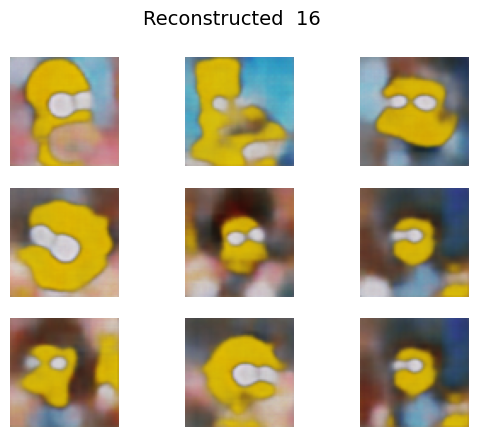


Epoch:  17
1/1 [==============================] - 0s 22ms/step


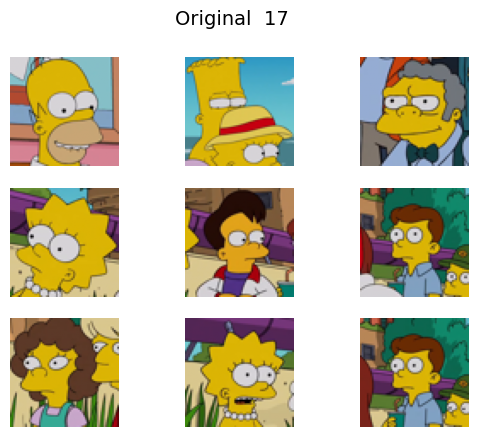

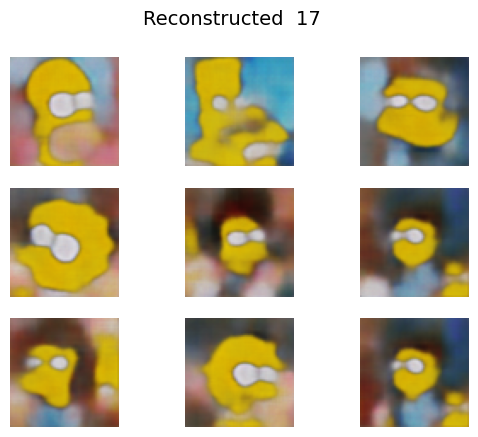


Epoch:  18
1/1 [==============================] - 0s 22ms/step


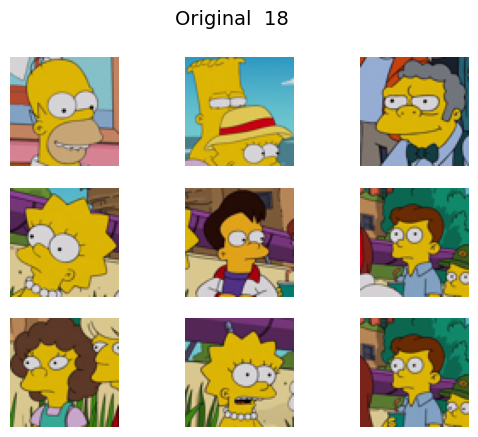

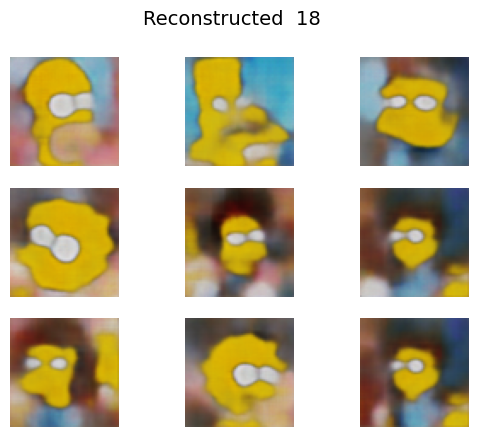


Epoch:  19
1/1 [==============================] - 0s 22ms/step


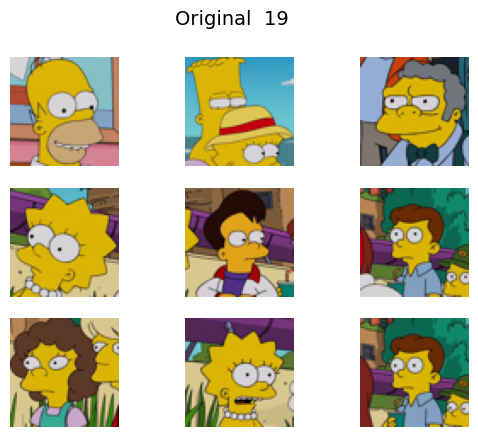

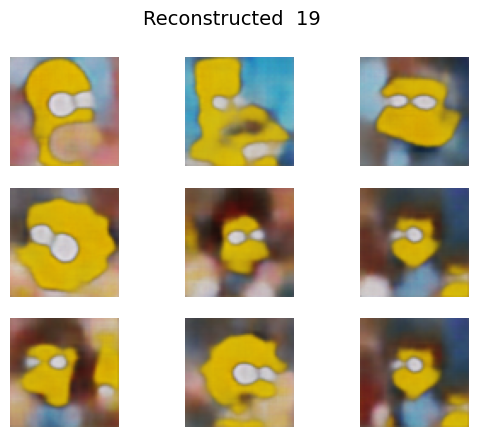


Epoch:  20
1/1 [==============================] - 0s 22ms/step


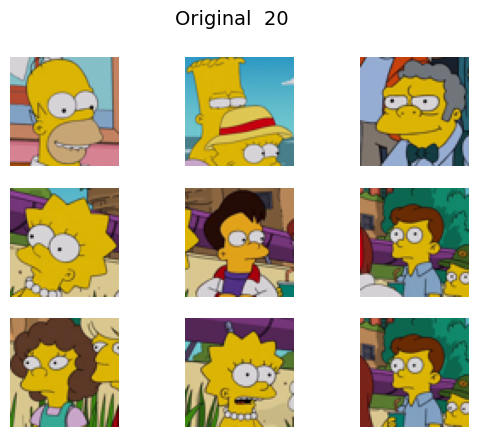

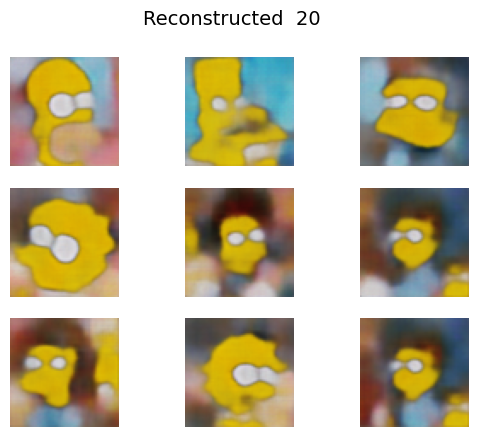


Epoch:  21
1/1 [==============================] - 0s 22ms/step


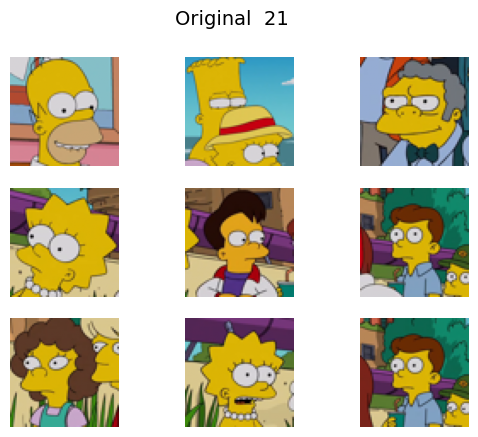

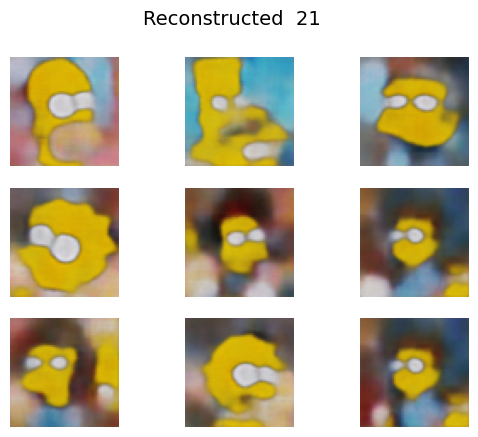


Epoch:  22
1/1 [==============================] - 0s 23ms/step


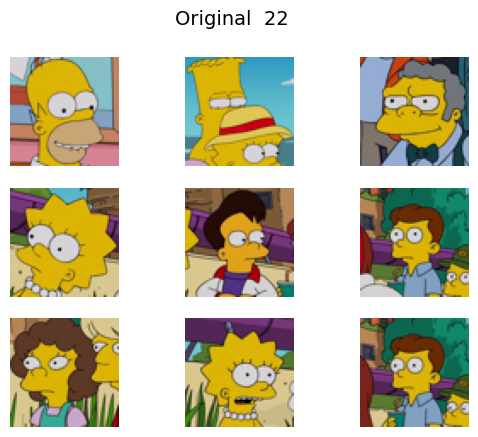

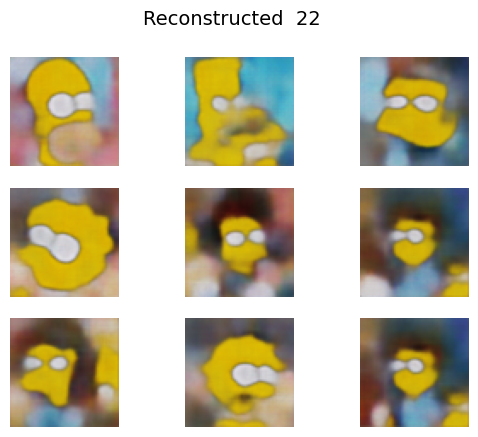


Epoch:  23
1/1 [==============================] - 0s 23ms/step


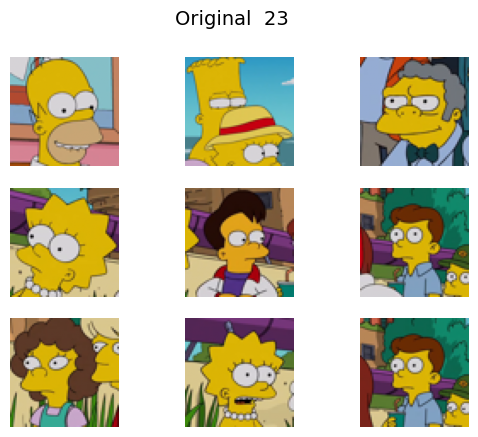

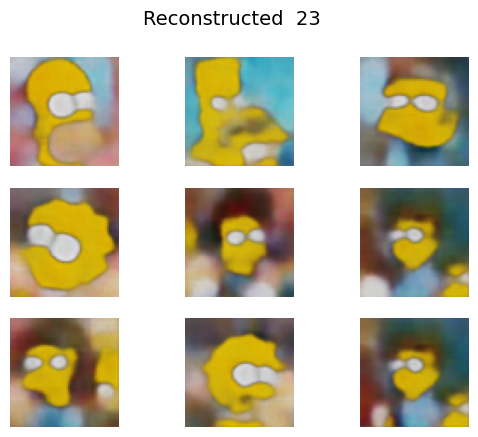


Epoch:  24
1/1 [==============================] - 0s 22ms/step


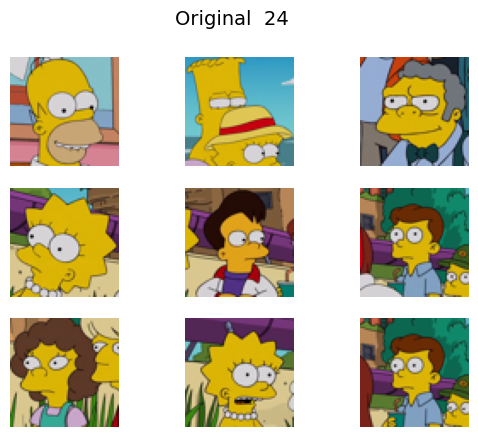

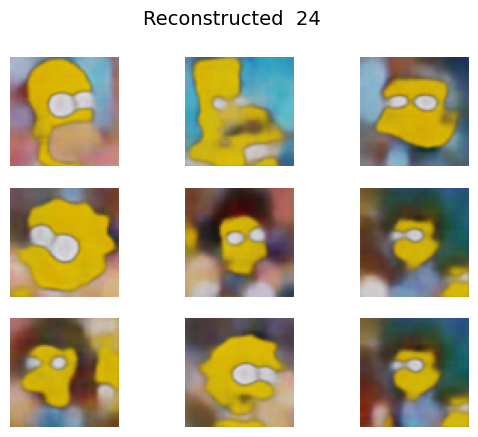


Epoch:  25
1/1 [==============================] - 0s 22ms/step


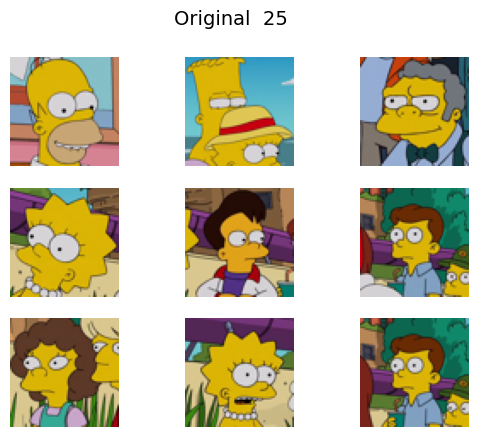

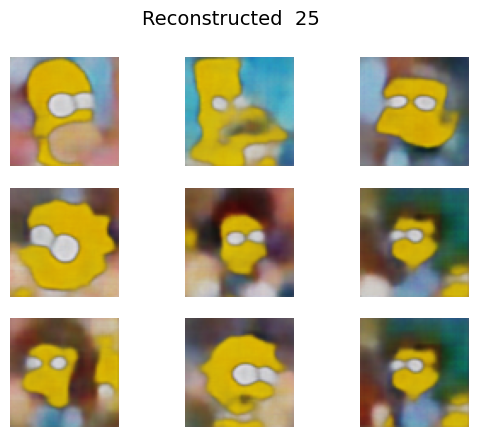


Epoch:  26
1/1 [==============================] - 0s 23ms/step


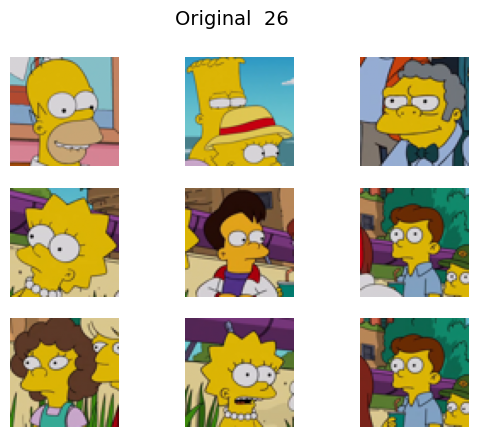

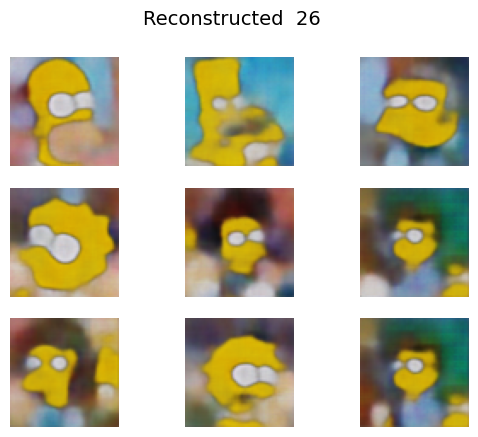


Epoch:  27
1/1 [==============================] - 0s 22ms/step


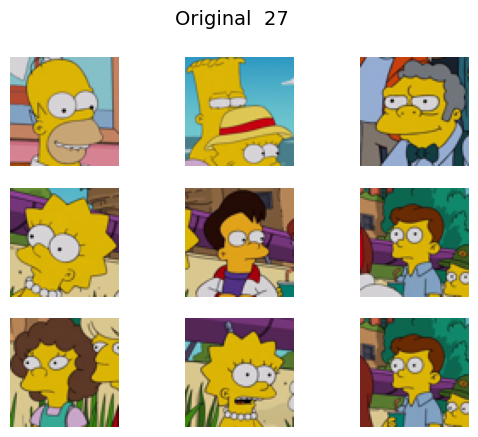

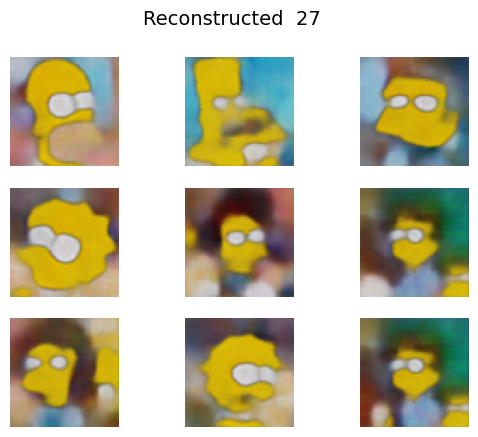


Epoch:  28
1/1 [==============================] - 0s 23ms/step


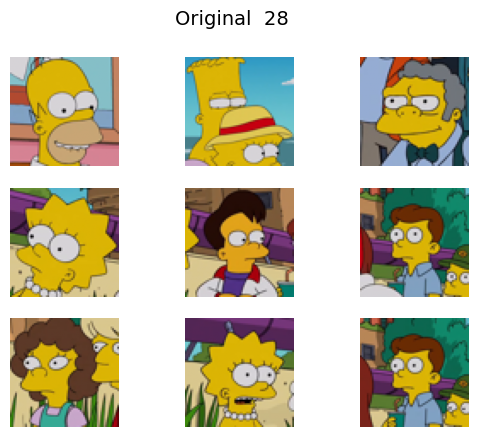

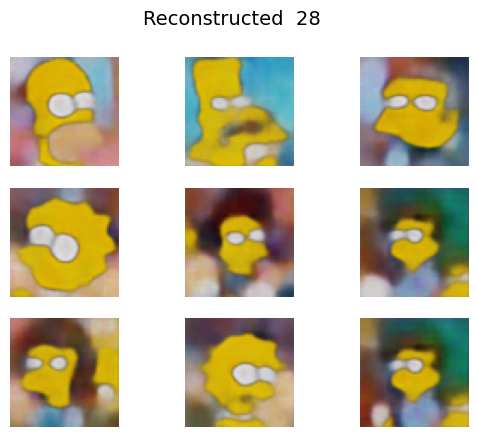


Epoch:  29
1/1 [==============================] - 0s 23ms/step


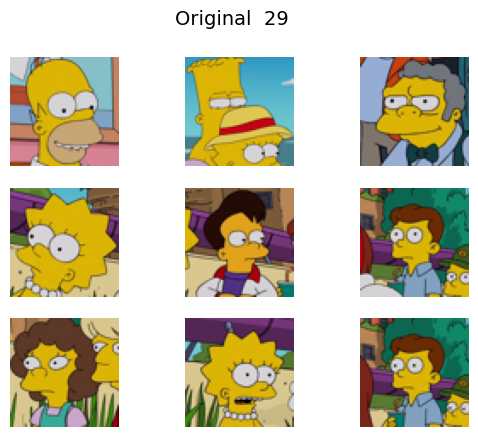

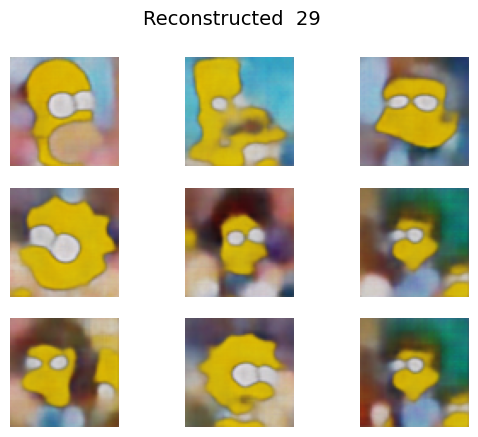


Epoch:  30
1/1 [==============================] - 0s 23ms/step


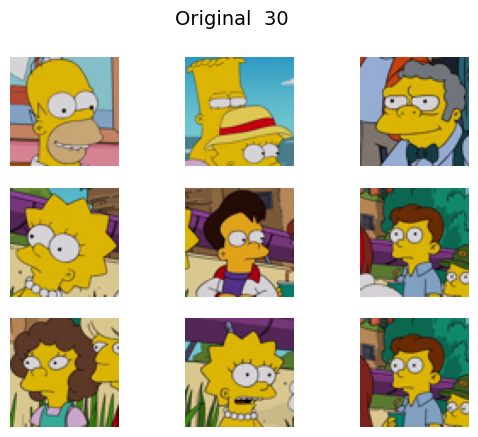

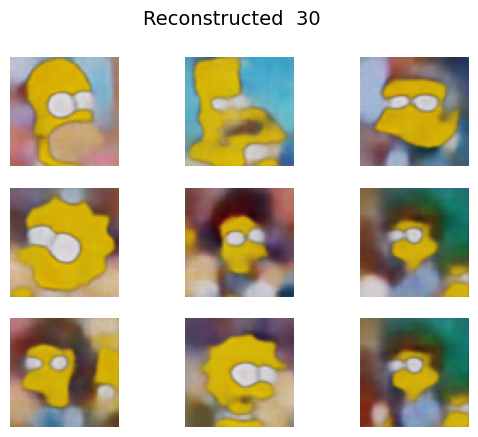


Epoch:  31
1/1 [==============================] - 0s 23ms/step


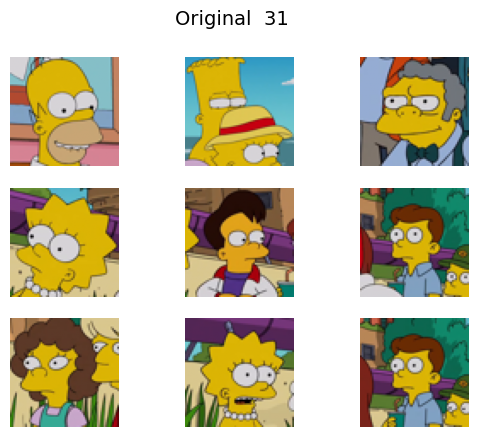

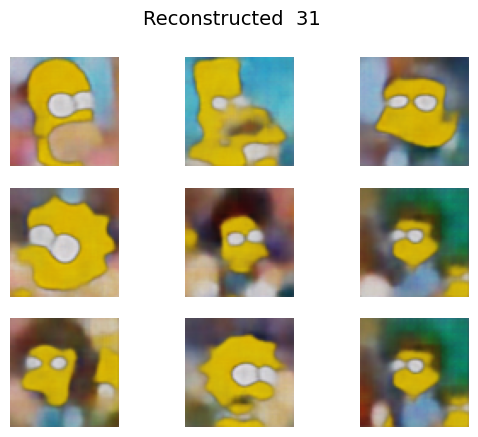


Epoch:  32
1/1 [==============================] - 0s 26ms/step


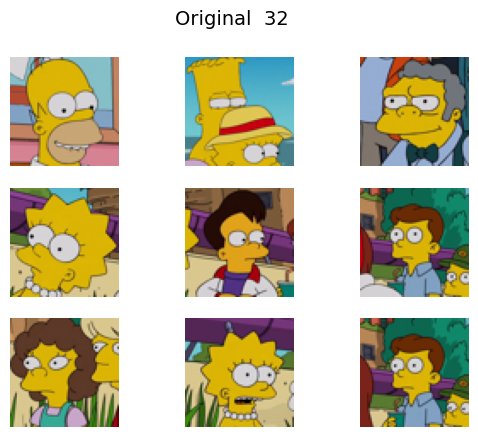

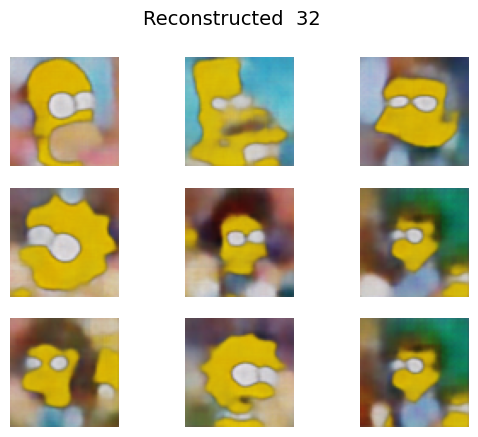


Epoch:  33
1/1 [==============================] - 0s 23ms/step


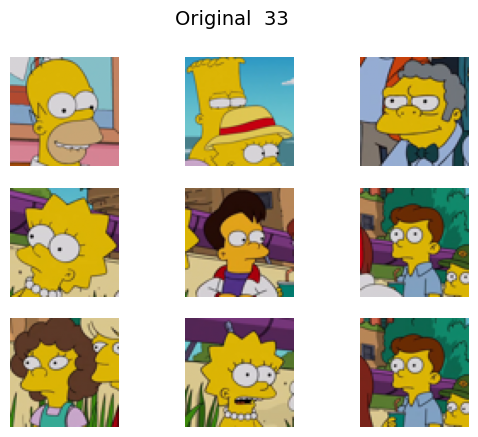

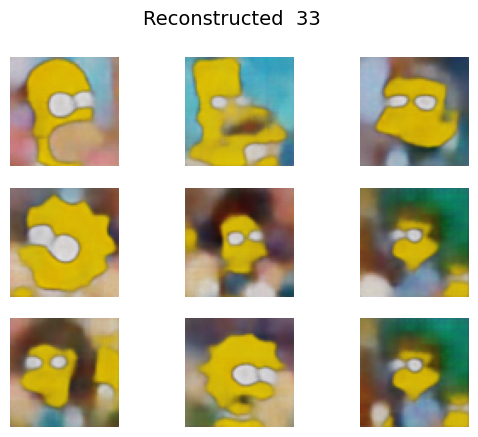


Epoch:  34
1/1 [==============================] - 0s 22ms/step


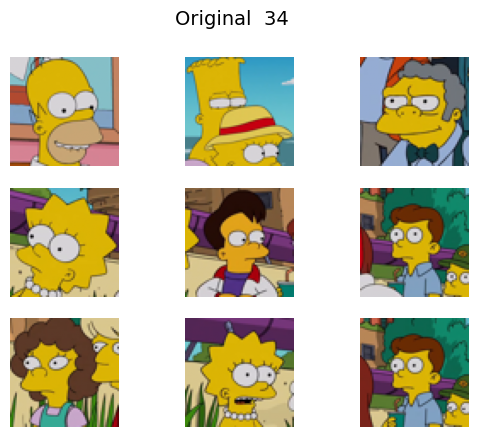

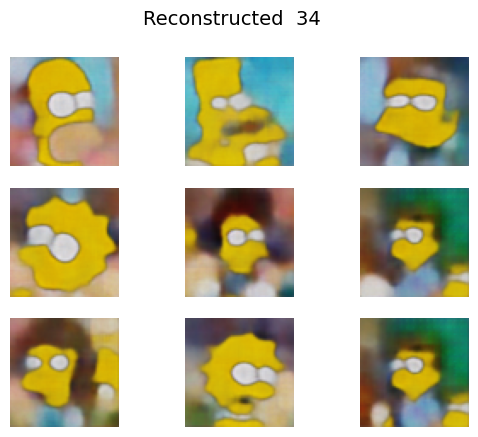


Epoch:  35
1/1 [==============================] - 0s 24ms/step


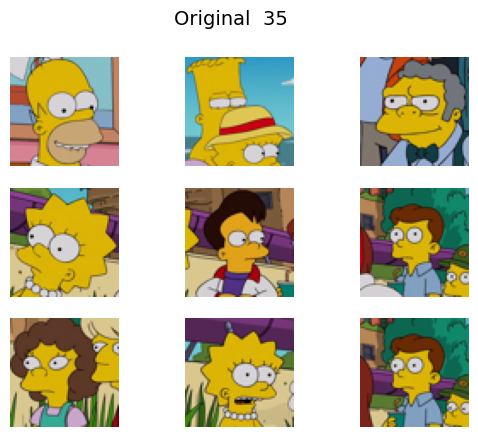

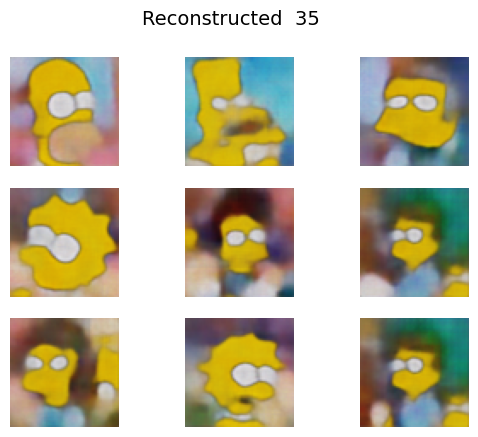


Epoch:  36
1/1 [==============================] - 0s 23ms/step


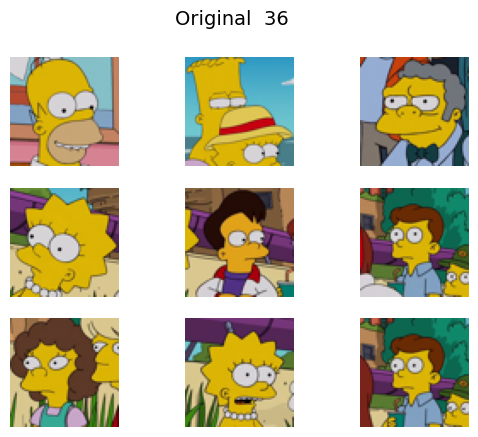

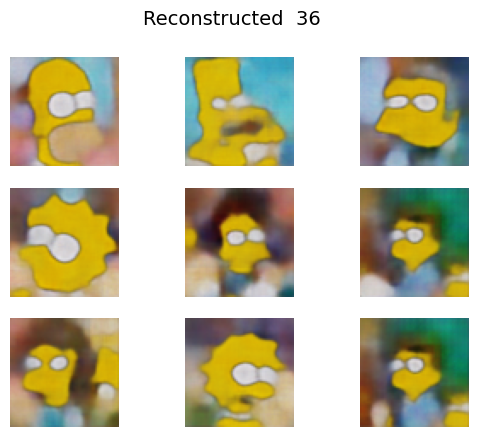


Epoch:  37
1/1 [==============================] - 0s 22ms/step


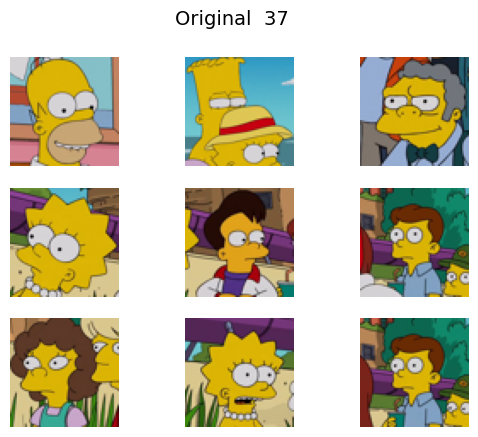

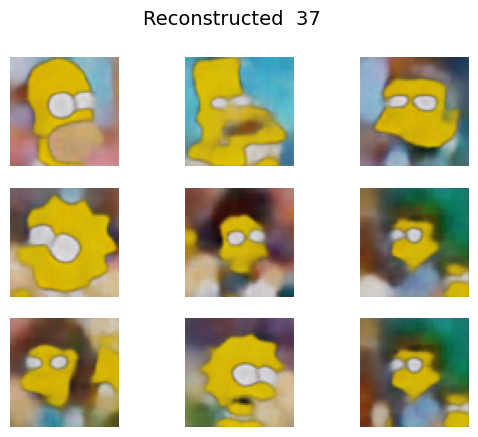


Epoch:  38
1/1 [==============================] - 0s 22ms/step


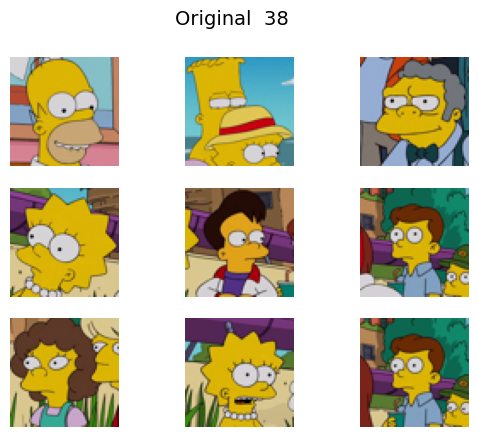

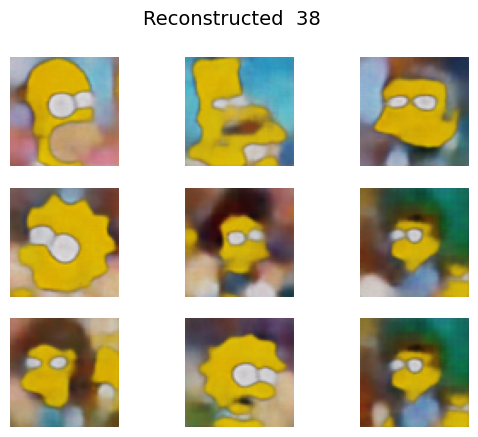


Epoch:  39
1/1 [==============================] - 0s 26ms/step


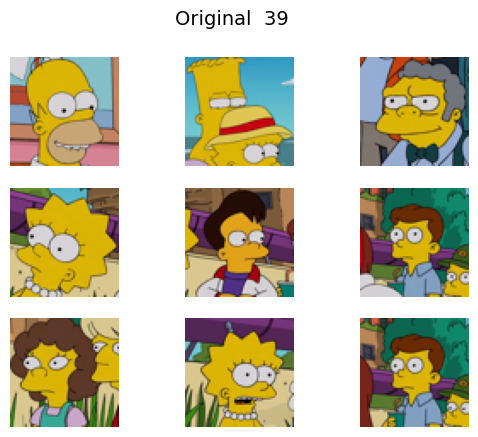

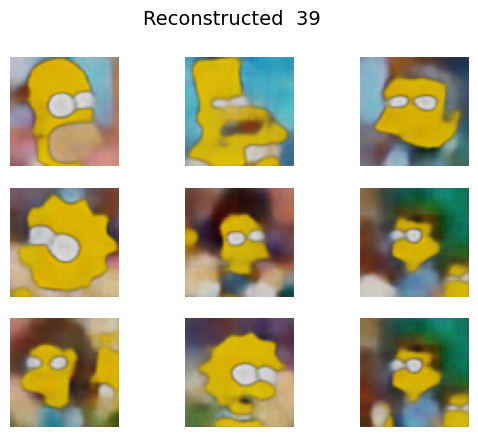


Epoch:  40
1/1 [==============================] - 0s 22ms/step


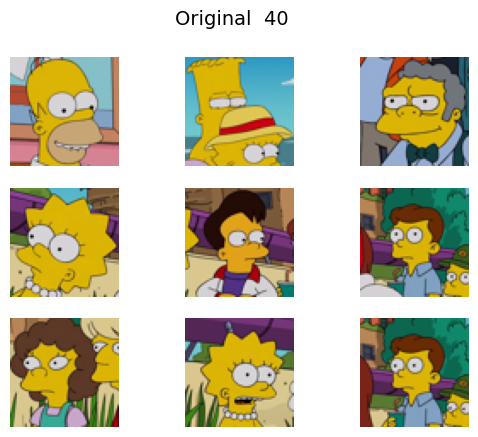

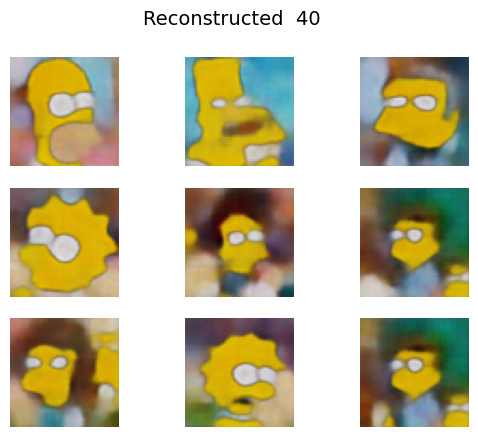


Epoch:  41
1/1 [==============================] - 0s 23ms/step


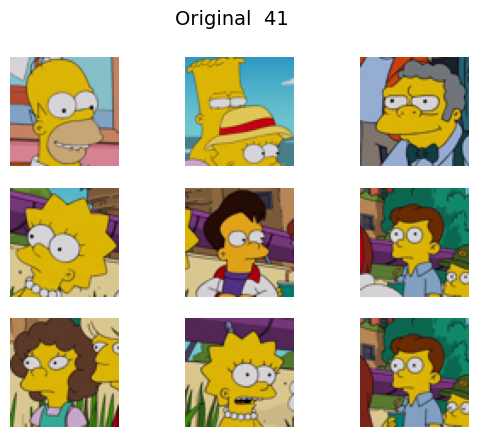

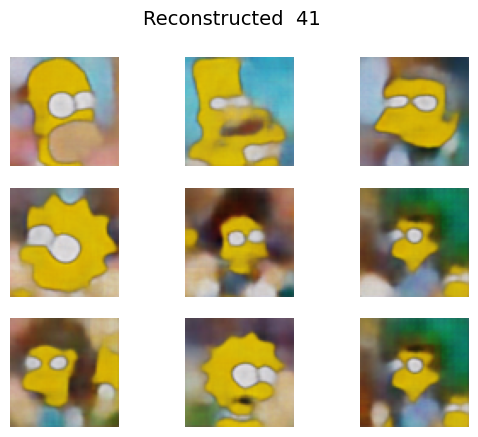


Epoch:  42
1/1 [==============================] - 0s 22ms/step


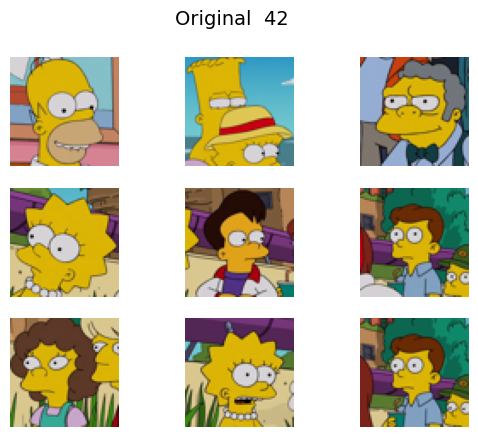

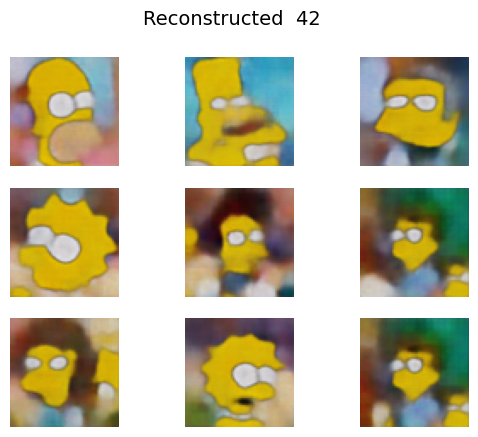


Epoch:  43
1/1 [==============================] - 0s 23ms/step


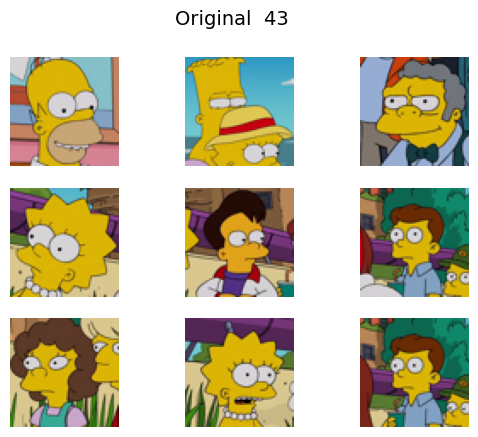

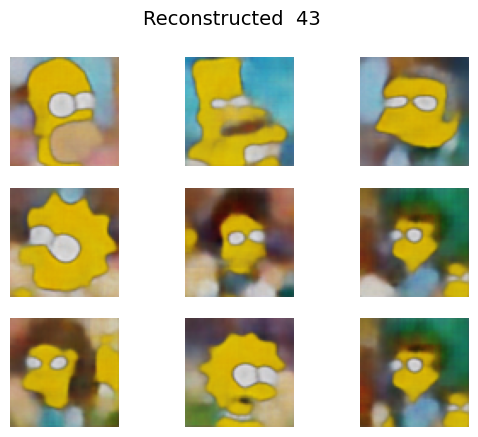


Epoch:  44
1/1 [==============================] - 0s 22ms/step


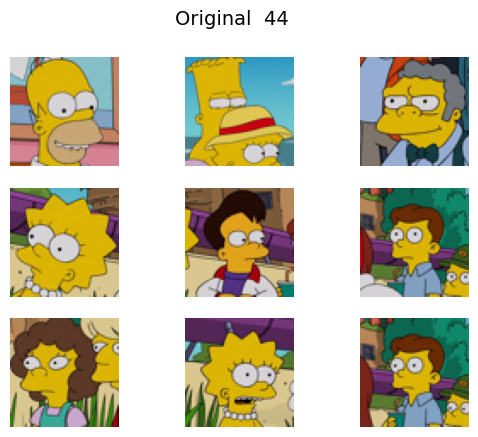

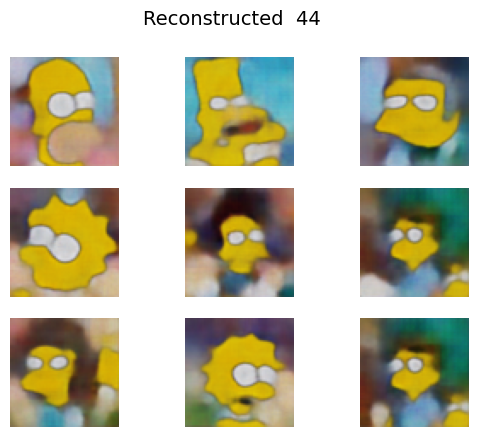


Epoch:  45
1/1 [==============================] - 0s 22ms/step


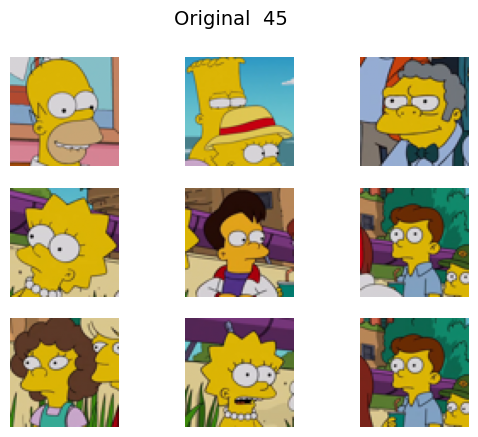

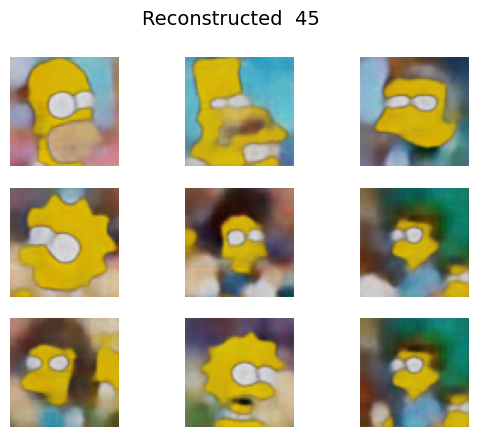


Epoch:  46
1/1 [==============================] - 0s 22ms/step


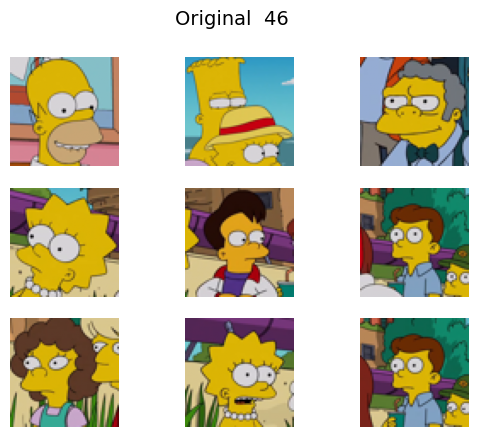

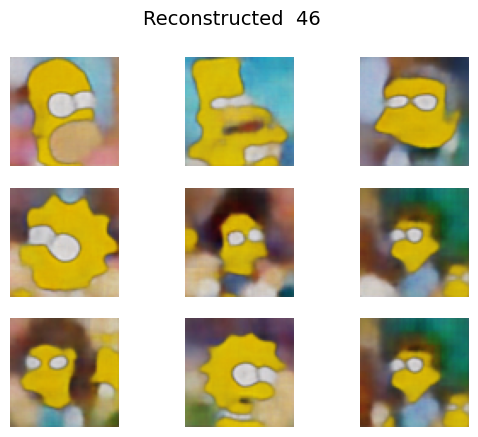


Epoch:  47
1/1 [==============================] - 0s 23ms/step


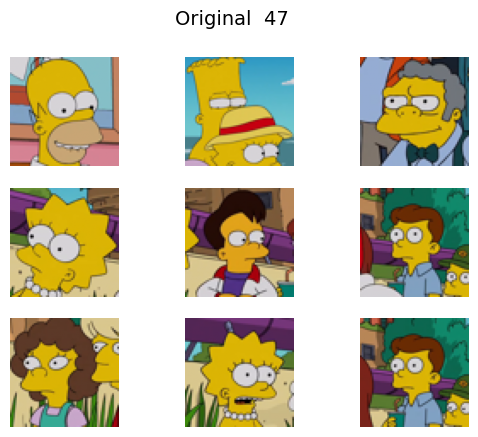

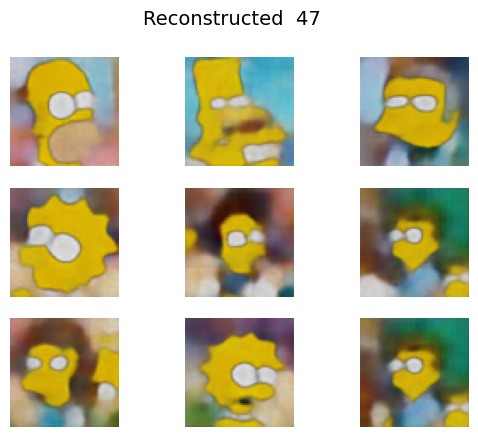


Epoch:  48
1/1 [==============================] - 0s 22ms/step


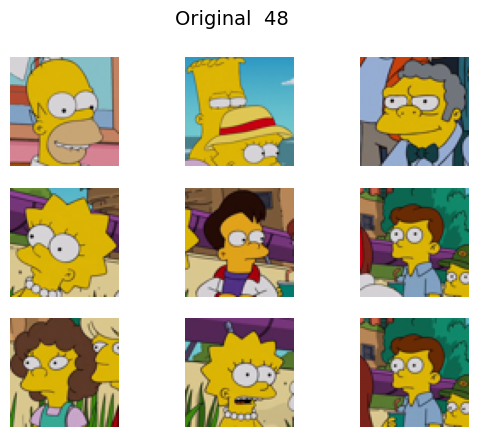

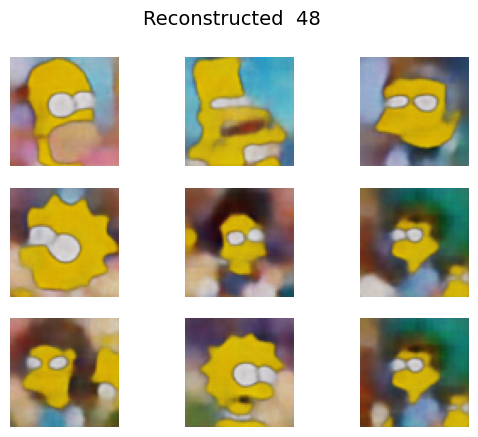


Epoch:  49
1/1 [==============================] - 0s 22ms/step


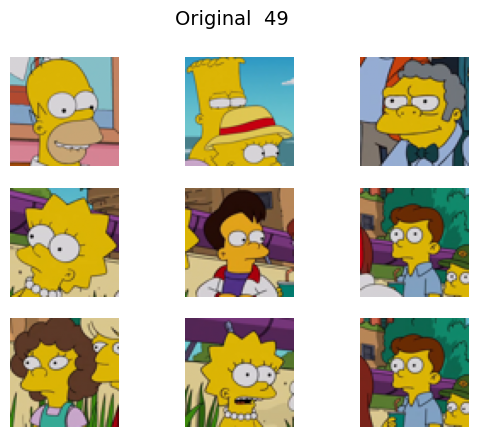

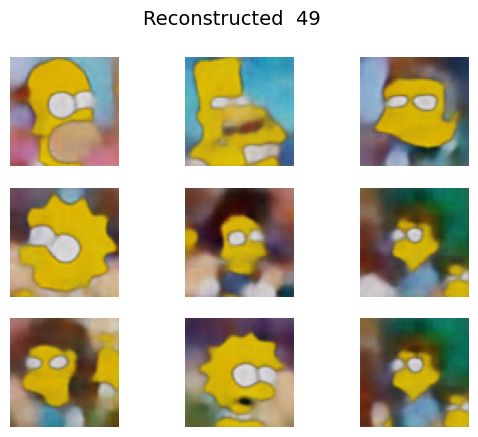

In [7]:
# Defining the model dimensions and building it
image_size = dataset.shape[1:]
latent_dim = 128
num_filters = 128
cae = build_convolutional_autoencoder(image_size, latent_dim, num_filters)


## Training the Convolutional autoencoder to reconstruct images
for epoch in range(50):
    print('\nEpoch: ', epoch)

    # Note that (X=y) when training autoencoders!
    # In this case we only care about qualitative performance, we don't split into train/test sets
    cae.fit(x=dataset, y=dataset, epochs=1, batch_size=64)

    samples = dataset[:9]
    reconstructed = cae.predict(samples)
    grid_plot(samples, epoch, name='Original', n=3, save=False)
    grid_plot(reconstructed, epoch, name='Reconstructed', n=3, save=False)

Model: "Encoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 enc_input (Conv2D)          (None, 32, 32, 64)        1792      
                                                                 
 conv2d_4 (Conv2D)           (None, 16, 16, 64)        36928     
                                                                 
 conv2d_5 (Conv2D)           (None, 8, 8, 64)          36928     
                                                                 
 conv2d_6 (Conv2D)           (None, 4, 4, 64)          36928     
                                                                 
 conv2d_7 (Conv2D)           (None, 2, 2, 64)          36928     
                                                                 
 flatten_1 (Flatten)         (None, 256)               0   

Model: "Decoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 32)]              0         
                                                                 
 dec_input (Dense)           (None, 1024)              33792     
                                                                 
 reshape_1 (Reshape)         (None, 4, 4, 64)          0         
                                                                 
 conv2d_transpose_4 (Conv2D  (None, 8, 8, 64)          36928     
 Transpose)                                                      
                                                                 
 conv2d_transpose_5 (Conv2D  (None, 16, 16, 64)        36928     
 Transpose)                                                      
                                                                 
 conv2d_transpose_6 (Conv2D  (None, 32, 32, 64)        3692

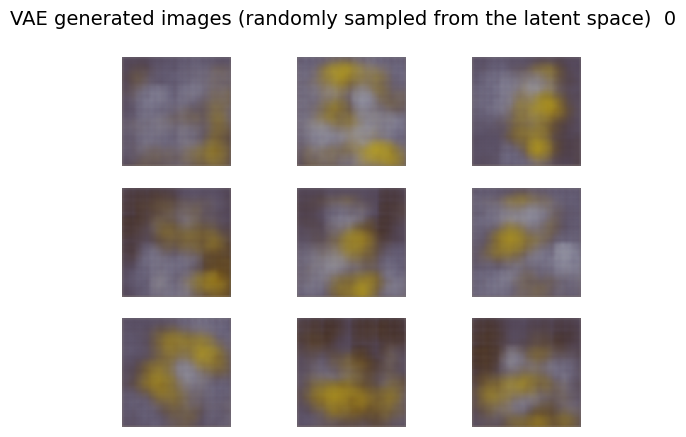

618/618 [==============================] - 9s 14ms/step - loss: 0.5711


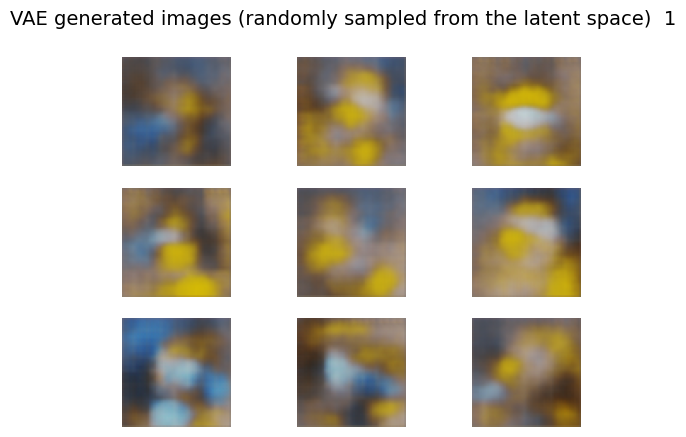

618/618 [==============================] - 9s 15ms/step - loss: 0.5619


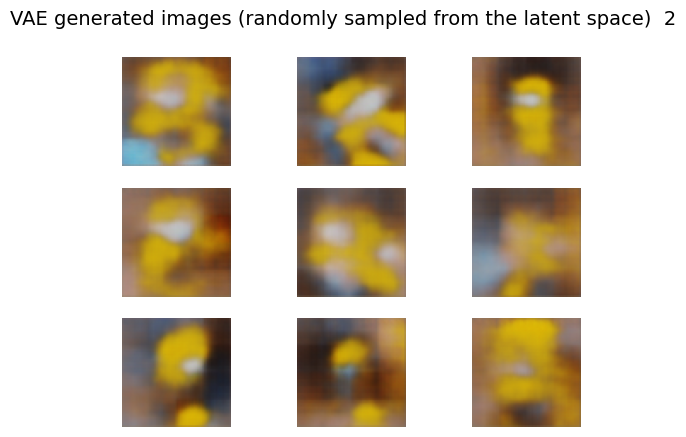

618/618 [==============================] - 9s 15ms/step - loss: 0.5573


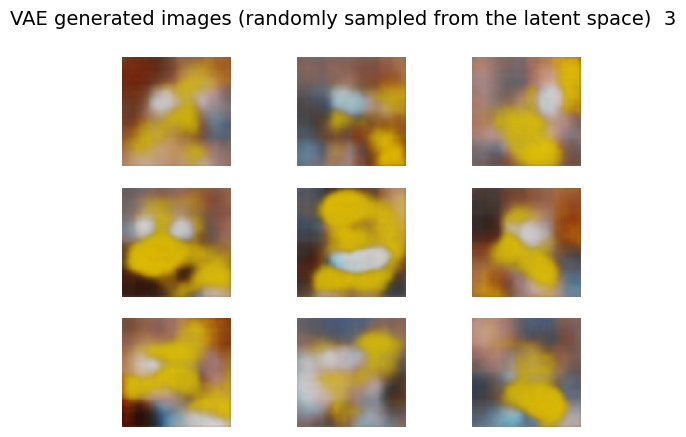

618/618 [==============================] - 10s 16ms/step - loss: 0.5547


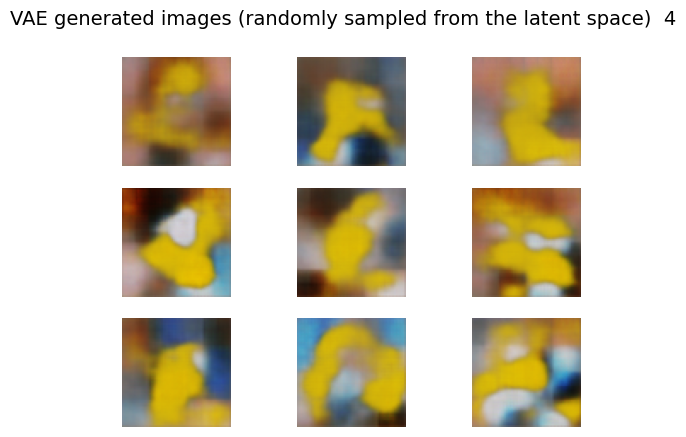

618/618 [==============================] - 10s 16ms/step - loss: 0.5532


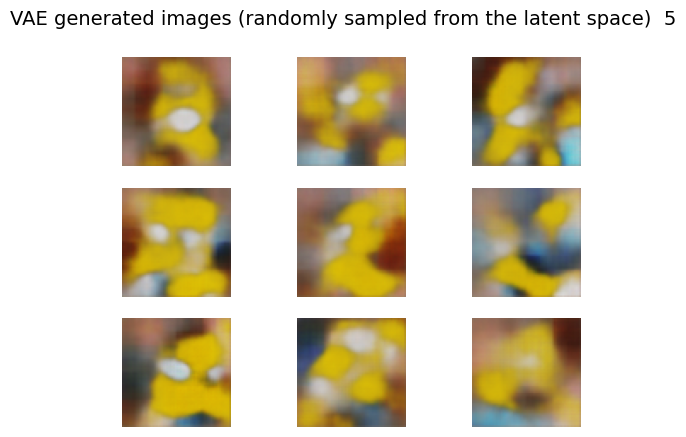

618/618 [==============================] - 10s 16ms/step - loss: 0.5521


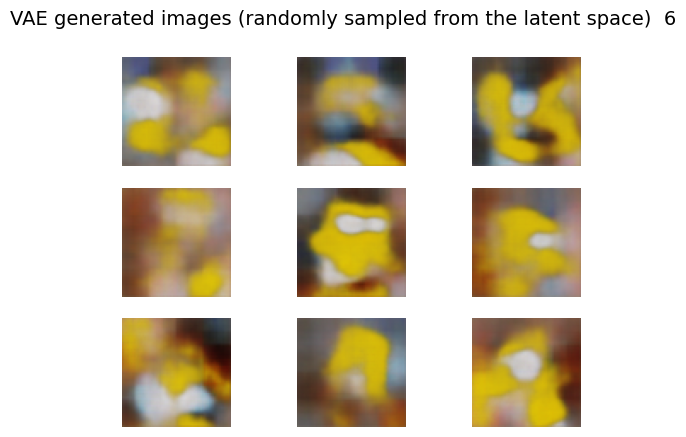

618/618 [==============================] - 10s 16ms/step - loss: 0.5512


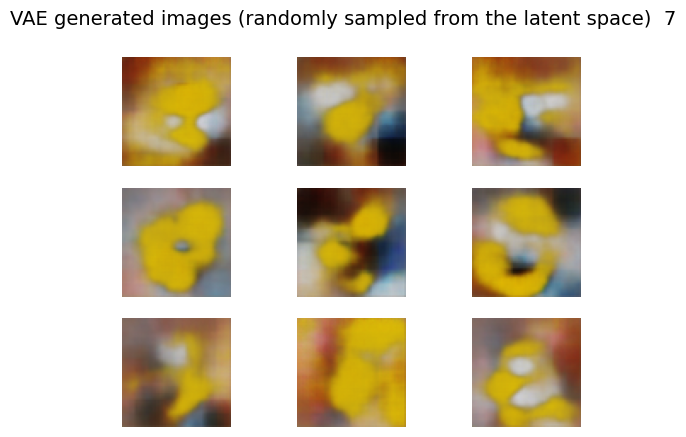

618/618 [==============================] - 10s 16ms/step - loss: 0.5506


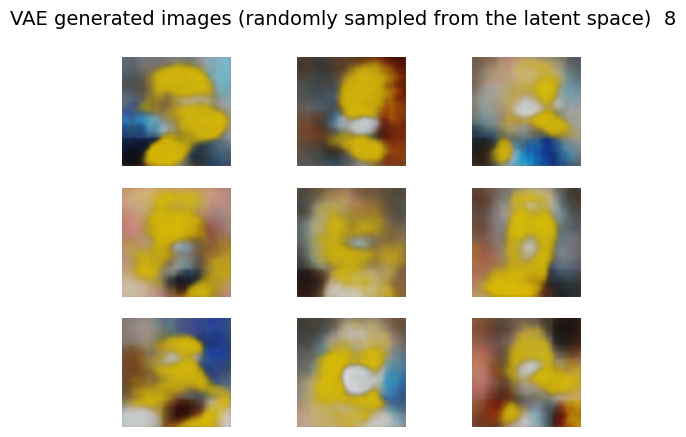

618/618 [==============================] - 11s 18ms/step - loss: 0.5500


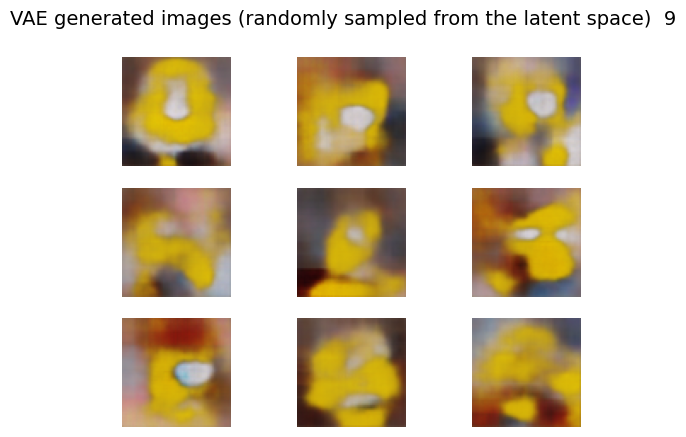

618/618 [==============================] - 11s 18ms/step - loss: 0.5496


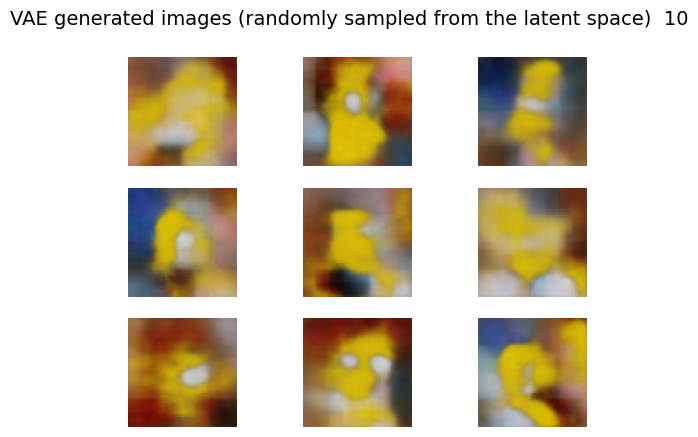

618/618 [==============================] - 11s 18ms/step - loss: 0.5491


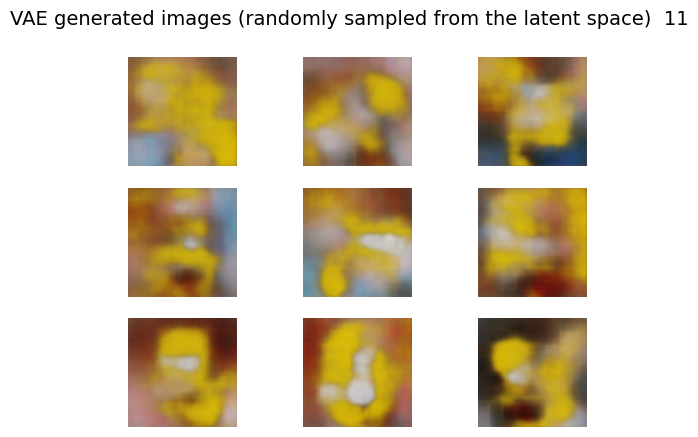

618/618 [==============================] - 11s 18ms/step - loss: 0.5487


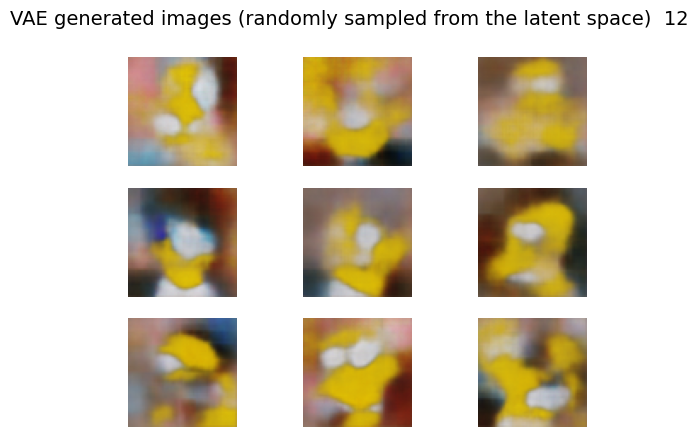

618/618 [==============================] - 11s 18ms/step - loss: 0.5483


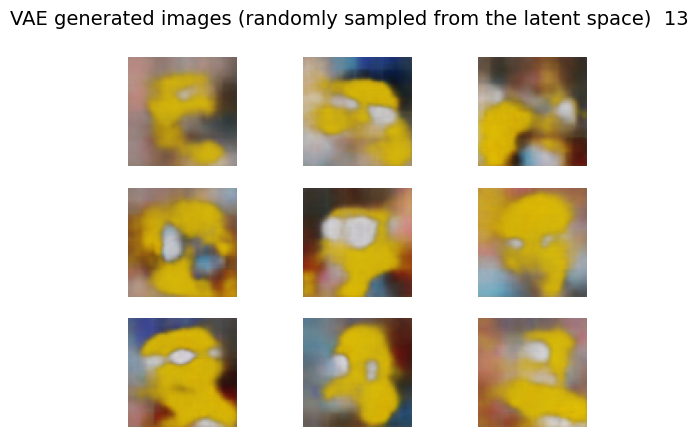

618/618 [==============================] - 11s 18ms/step - loss: 0.5480


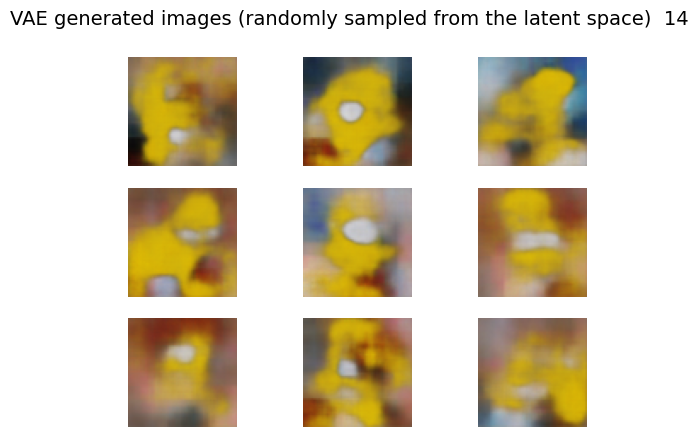

618/618 [==============================] - 11s 19ms/step - loss: 0.5478


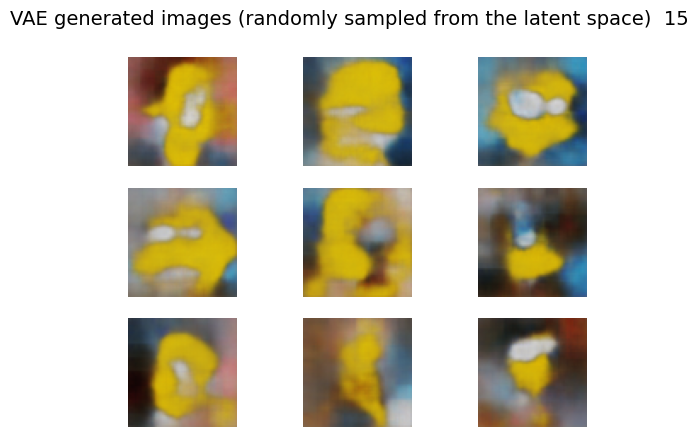

618/618 [==============================] - 11s 18ms/step - loss: 0.5475


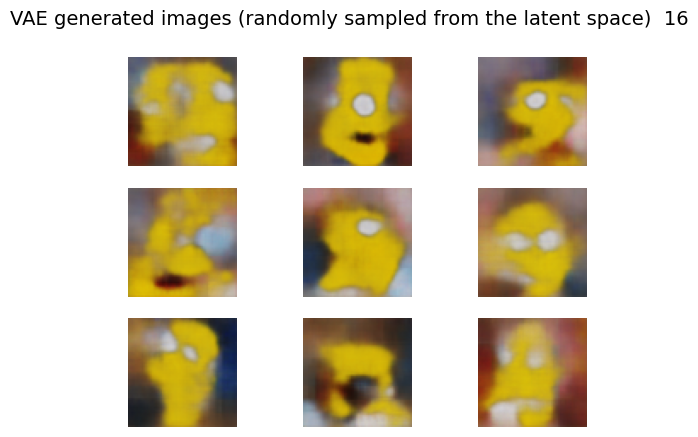

618/618 [==============================] - 11s 18ms/step - loss: 0.5472


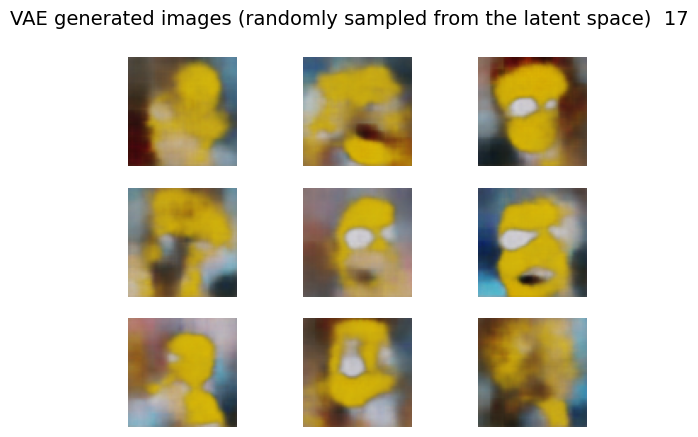

618/618 [==============================] - 11s 18ms/step - loss: 0.5470


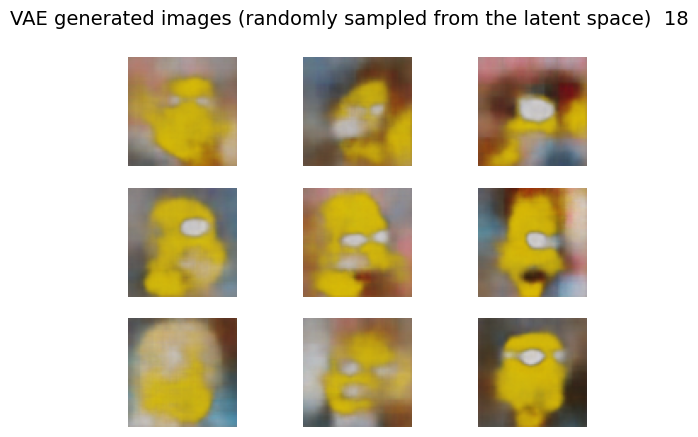

618/618 [==============================] - 11s 19ms/step - loss: 0.5467


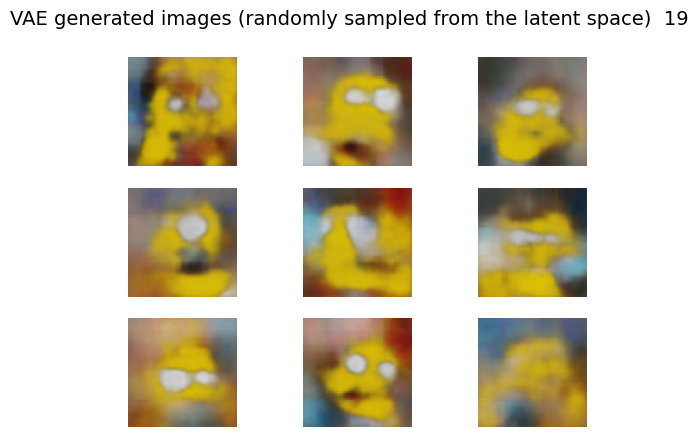

In [8]:
# Training the VAE model

latent_dim = 32
encoder, decoder, vae = build_vae(dataset.shape[1:], latent_dim, filters=64)

for epoch in range(20):
    vae.fit(x=dataset, y=dataset, epochs=1, batch_size=16)

    # Generate random vectors that we will use to sample from the learned latent space
    coefficient = 4 #You can tweak this coefficient to increase/decrease the std of the sampled vectors
    latent_vectors = np.random.randn(9, latent_dim) # Generate 9 random points in the latent space
    images = decoder(latent_vectors / coefficient)  # Feed the vectors scaled by the coefficient to the model
    grid_plot(images, epoch, name='VAE generated images (randomly sampled from the latent space)', n=3, save=False)

Interpolation

In [7]:
def interpolate_latent(latent_dim, steps=10):
    """
    Interpolates between two random points in latent space
    
    args:
    - latent_dim: dimensionality of latent space
    - steps: number of interpolation steps
    
    output:
    - interpolated_vectors: array of shape (steps, latent_dim)
    """
    # select two random latent vectors
    z1 = np.random.randn(1, latent_dim)
    z2 = np.random.randn(1, latent_dim)
    
    #interpolate between them
    interpolated_vectors = []
    for i in range(steps):
        alpha = i / (steps - 1)
        z = (1 - alpha) * z1 + alpha * z2
        interpolated_vectors.append(z)
    interpolated_vectors = np.vstack(interpolated_vectors)
    
    return interpolated_vectors

def generate_interpolated_images(decoder, latent_dim, name):
    """
    Generate and plot interpolated images from the latent space using the decoder (for VAE)/encoder (for GAN)
    """
    steps = 10
    interpolated_vectors = interpolate_latent(latent_dim, steps=steps)
    images = decoder.predict(interpolated_vectors)
    #grid_plot(images, name='Interpolated Images', n=1, save=False)
    plt.figure(figsize=(steps * 2, 2))
    for i, img in enumerate(images):
        plt.subplot(1, steps, i + 1)
        plt.imshow(img)
        plt.axis('off')
    plt.suptitle(f'Interpolated Images {name}', fontsize=20)
    plt.savefig(f'interpolated_images{name}.png')
    plt.show()
    

1/1 [==============================] - 0s 13ms/step


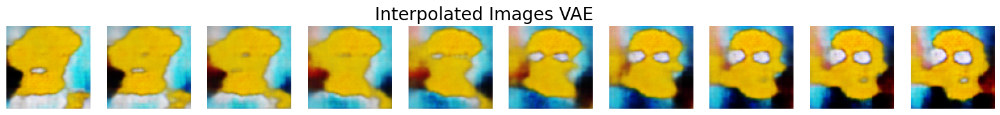

In [18]:
# VAE Interpolation
latent_dim = 32
generate_interpolated_images(decoder, latent_dim, 'VAE')

Model: "Decoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 128)]             0         
                                                                 
 dec_input (Dense)           (None, 1024)              132096    
                                                                 
 reshape (Reshape)           (None, 4, 4, 64)          0         
                                                                 
 conv2d_transpose (Conv2DTr  (None, 8, 8, 128)         73856     
 anspose)                                                        
                                                                 
 conv2d_transpose_1 (Conv2D  (None, 16, 16, 128)       147584    
 Transpose)                                                      
                                                                 
 conv2d_transpose_2 (Conv2D  (None, 32, 32, 128)       1475

100%|██████████| 154/154 [00:37<00:00,  4.16it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99782497..0.98216283].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99811023..0.97957057].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.97498715..0.8850994].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9918104..0.95077246].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99949616..0.99189913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99878657..0.9830137].
Clipping input data to the valid range for imshow with RGB data ([0..1]

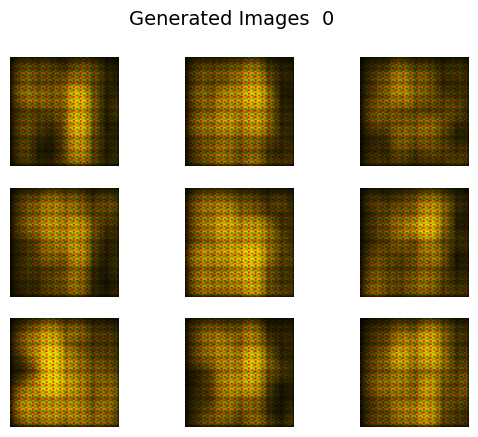

100%|██████████| 154/154 [00:39<00:00,  3.94it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.94624454..0.97940344].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99719256..0.9995541].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.94999725..0.9811299].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9985998..0.9998139].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9880197..0.9974812].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.94469315..0.97830516].
Clipping input data to the valid range for imshow with RGB data ([0..1] fo

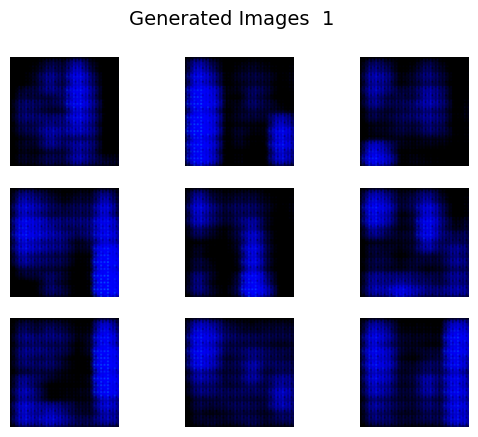

100%|██████████| 154/154 [00:39<00:00,  3.93it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9974237..0.855275].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9963248..0.70616174].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9996626..0.90208966].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9979525..0.86659926].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999547..0.97716737].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99814445..0.6757212].
Clipping input data to the valid range for imshow with RGB data ([0..1] for

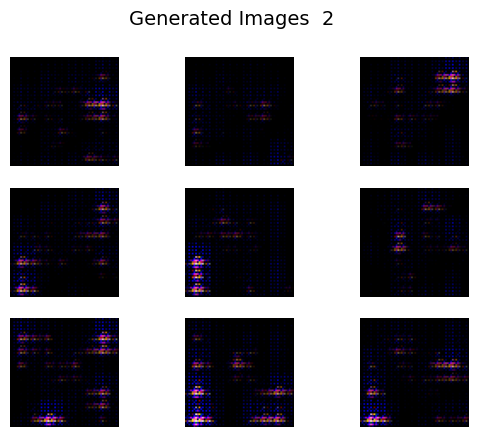

100%|██████████| 154/154 [00:39<00:00,  3.93it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.92596585..0.9999885].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.68291825..0.99008125].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7971719..0.99605715].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7653015..0.99118614].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.82191825..0.99950624].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7880057..0.9937809].
Clipping input data to the valid range for imshow with RGB data ([0..1] f

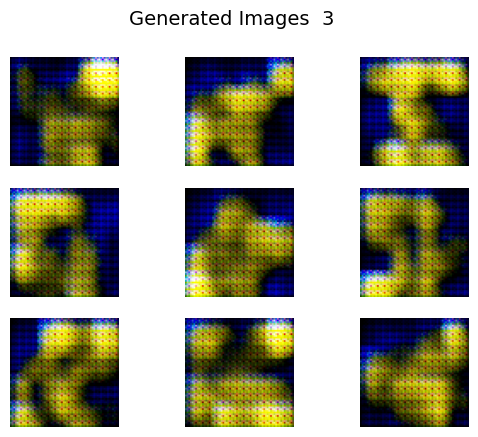

100%|██████████| 154/154 [00:39<00:00,  3.92it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999833..0.9986068].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999979..0.99621767].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999918..0.9994386].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999995].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999998].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99996287..1.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] 

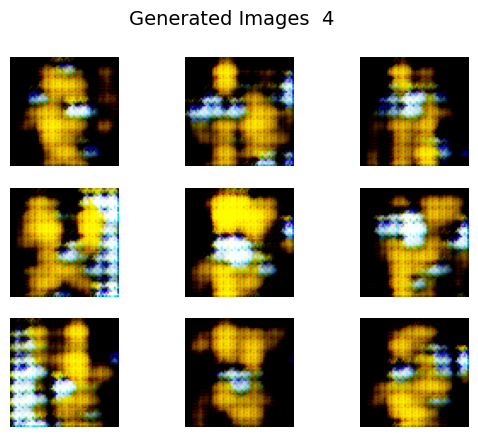

100%|██████████| 154/154 [00:39<00:00,  3.92it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999745..0.9999948].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999171..0.9985327].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99998975..0.9951577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9995337..0.9888099].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99998206..0.99948764].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99995065..0.99944043].
Clipping input data to the valid range for imshow with RGB data ([0..1] for

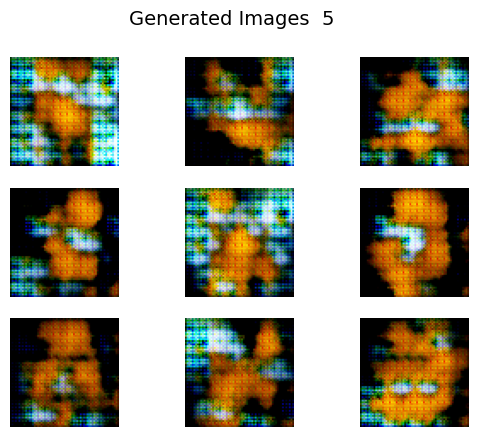

100%|██████████| 154/154 [00:39<00:00,  3.92it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9993955..0.95109963].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99877137..0.99091107].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99987453..0.99904335].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9996479..0.9911817].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999663..0.9802445].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9997327..0.9732774].
Clipping input data to the valid range for imshow with RGB data ([0..1] for

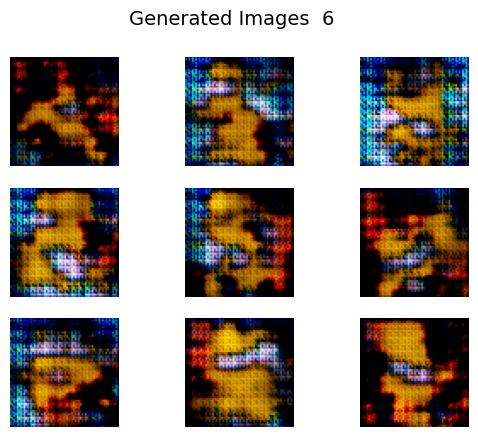

100%|██████████| 154/154 [00:39<00:00,  3.92it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9996748..0.96053076].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99982435..0.9966949].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9978205..0.9943563].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999975..0.99915147].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9994497..0.9921839].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99712896..0.99457604].
Clipping input data to the valid range for imshow with RGB data ([0..1] for

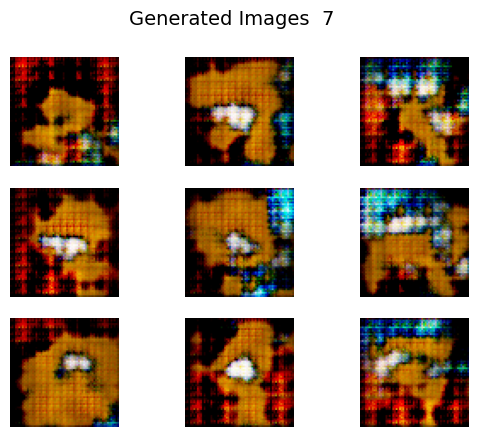

100%|██████████| 154/154 [00:39<00:00,  3.92it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999561..0.9916009].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999905..0.99947625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999513].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999562..0.995154].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999915..0.99782026].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99866027..0.9987369].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats 

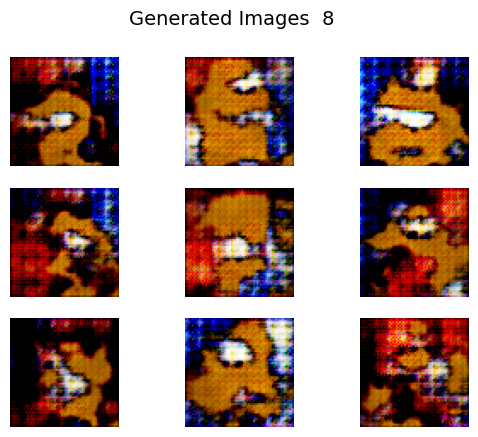

100%|██████████| 154/154 [00:39<00:00,  3.93it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99997216..0.99884635].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99994636..0.999425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999944..0.99843174].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999815..0.9999216].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999979..0.995873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999768..0.9998418].
Clipping input data to the valid range for imshow with RGB data ([0..1] for f

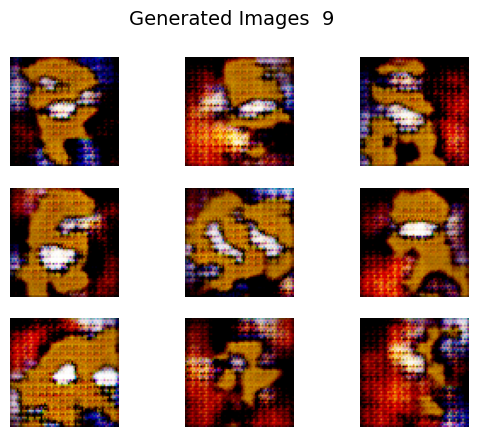

100%|██████████| 154/154 [00:39<00:00,  3.93it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9979524..0.9992185].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99967176].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999069..0.9976101].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99898154..0.98788494].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9945466].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9998864].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] 

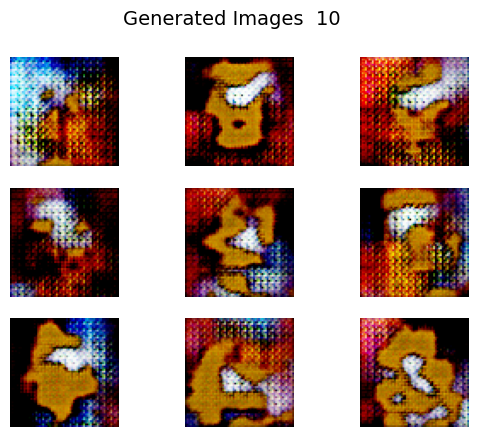

100%|██████████| 154/154 [00:39<00:00,  3.92it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.999998..0.97548664].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999964..0.99584806].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9881388].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999782..0.97248447].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999973..0.9913998].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999556..0.9804799].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats 

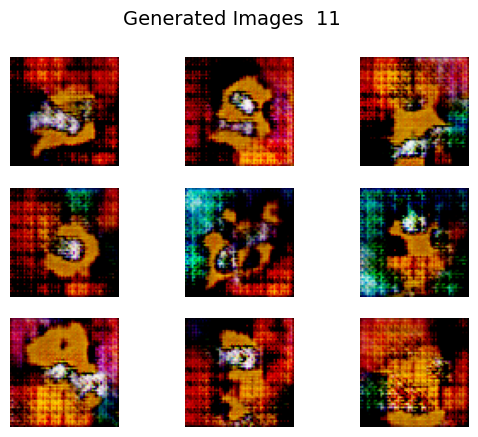

100%|██████████| 154/154 [00:39<00:00,  3.89it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.988502].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96385396].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99246854].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9998926..0.9597632].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.95875365].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.94336724].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers

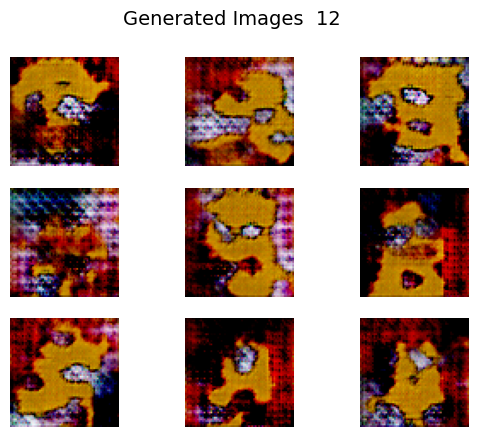

100%|██████████| 154/154 [00:39<00:00,  3.92it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.91912985].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99777794].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.88820523].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9336108].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.948663].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.93445265].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got

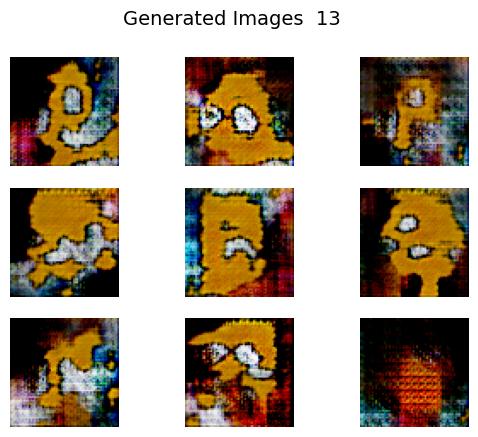

100%|██████████| 154/154 [00:39<00:00,  3.92it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9681088].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.98990834].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.95419604].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.88714963].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96791565].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9648931].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Go

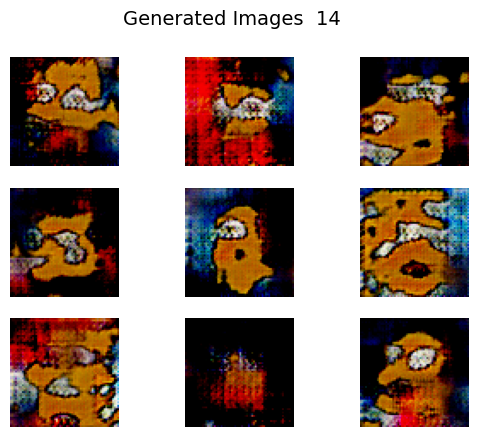

100%|██████████| 154/154 [00:39<00:00,  3.92it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999685..0.93856615].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96795696].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96707857].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9864124].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.999998..0.94346917].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999934..0.973044].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] 

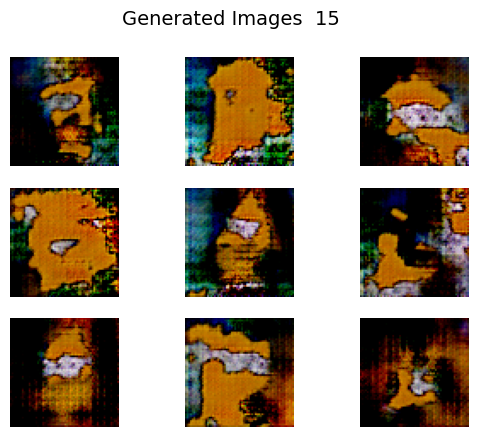

100%|██████████| 154/154 [00:39<00:00,  3.90it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9443568].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.993604].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9844115].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9852345].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9347243].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96607435].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got ra

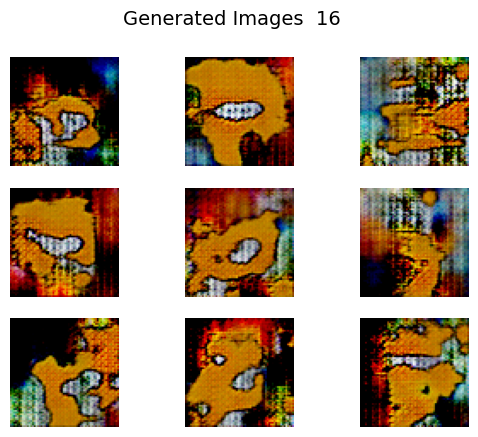

100%|██████████| 154/154 [00:40<00:00,  3.81it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.95639884].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.97695273].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9970503].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999992..0.9302924].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8790909].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999946..0.9258906].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for in

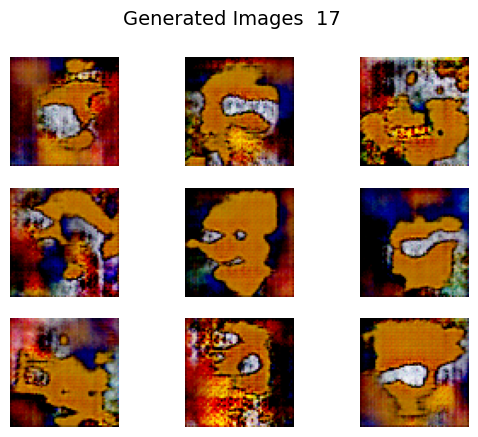

100%|██████████| 154/154 [00:40<00:00,  3.84it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.85691756].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9896426].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8897984].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999964..0.95044255].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999183..0.8868595].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9973297].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for i

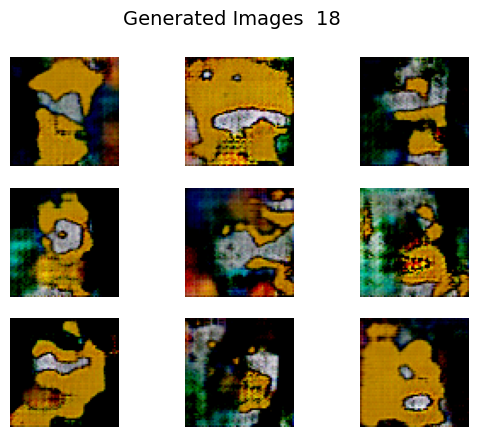

100%|██████████| 154/154 [00:39<00:00,  3.91it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9827738].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.92813873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9161434].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9943422].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.92024183].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99401057].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got

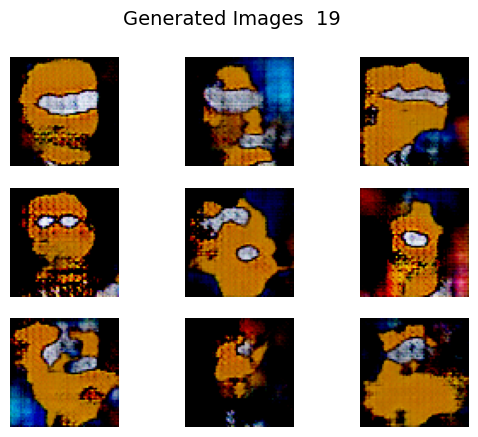

In [11]:
latent_dim = 128
discriminator, generator, gan = build_gan(dataset.shape[1:], latent_dim, filters=128)
dataset_scaled = ((X - 127.5) * 2)/ 255.

train_gan(generator, discriminator, gan, dataset_scaled, latent_dim, n_epochs=20)

1/1 [==============================] - 0s 17ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9811312].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9649383].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999946..0.93615174].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999577..0.90512764].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999946..0.91201806].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.90990114].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.94327396].
C

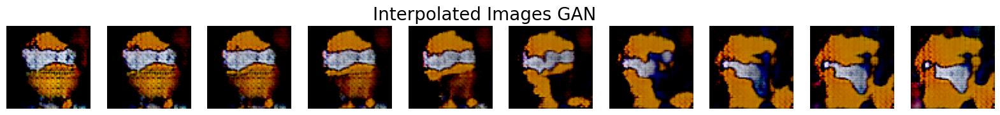

In [13]:
# GAN Interpolation
latent_dim = 128
generate_interpolated_images(generator, latent_dim, 'GAN')